In [1]:
import numpy as np
import os
import torch
import torch.nn as nn
import torch.nn.functional as F
import matplotlib.pyplot as plt
import imageio.v2 as imageio
import time

device = torch.device("cuda" if torch.cuda.is_available() else "cpu")
print(device)

cuda


In [2]:
def positional_encoding(x, num_frequencies=6, incl_input=True):

    results = []
    if incl_input:
        results.append(x)
    # encode input tensor and append the encoded tensor to the list of results.
    freq = torch.pow(2,torch.arange(num_frequencies)).to(device)
    sin_list = torch.sin(torch.pi*freq*x.reshape((-1,1))).to(device)
    cos_list  = torch.cos(torch.pi*freq*x.reshape((-1,1))).to(device)
    results.append(sin_list.reshape((x.shape[0],-1)))
    results.append(cos_list.reshape((x.shape[0],-1)))
    return torch.cat(results, dim=-1)


In [3]:
import os
import numpy as np
import torch
import torch.nn as nn
import matplotlib.pyplot as plt
import torch.nn.functional as F
import time

device = torch.device("cuda" if torch.cuda.is_available() else "cpu")
print(device)

cuda


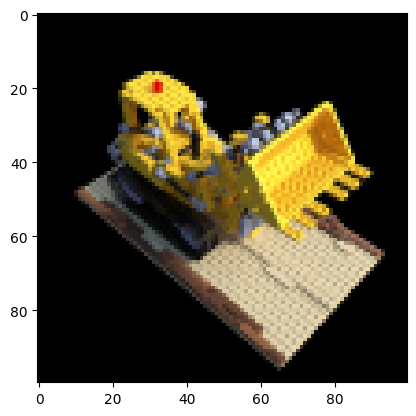

In [4]:
# Load input images, poses, and intrinsics
data = np.load("lego_data.npz")

# Images
images = data["images"]

# Height and width of each image
height, width = images.shape[1:3]

# Camera extrinsics (poses)
poses = data["poses"]
poses = torch.from_numpy(poses).to(device)

# Camera intrinsics
intrinsics = data["intrinsics"]
intrinsics = torch.from_numpy(intrinsics).to(device)

# Hold one image out (for test).
test_image, test_pose = images[101], poses[101]
test_image = torch.from_numpy(test_image).to(device)

# Map images to device
images = torch.from_numpy(images[:100, ..., :3]).to(device)

plt.imshow(test_image.detach().cpu().numpy())
plt.show()

In [5]:
def get_rays(height, width, intrinsics, w_R_c, w_T_c):

    device = intrinsics.device
    ray_directions = torch.zeros((height, width, 3), device=device)  # placeholder
    ray_origins = torch.zeros((height, width, 3), device=device)  # placeholder

    coords = torch.stack(torch.meshgrid(torch.arange(height), torch.arange(width), indexing='xy'), -1).reshape((-1,2))
    coords = torch.concat((coords, torch.ones(coords.shape[0],1)), -1).to(device)
    # print(w_R_c.dtype, intrinsics.dtype, coords.dtype, w_T_c.dtype)
    rays = w_R_c @ torch.linalg.inv(intrinsics) @ coords.T
    # print(rays[:2,...])
    # print(rays.shape)
    rays = rays/torch.norm(rays, dim=0)
    rays_directions = rays.T.reshape((height,width,3))
    rays_origins = torch.broadcast_to(w_T_c.T, ((height, width,3)))
    # print(rays_directions.shape, rays_directions[0,:2,:])
    # print(rays_origins.shape, rays_origins[0,:2,:])

    return rays_origins, rays_directions

In [ ]:
def plot_all_poses(poses):


    poses = torch.Tensor(poses).to(device)
    # print(poses.dtype)
    w_R_c = poses[:,:3,:3]
    w_T_c = poses[:,:3,3]
    origins = torch.zeros((poses.shape[0],height, width, 3))
    directions = torch.zeros((poses.shape[0],height, width, 3))
    for i in range(poses.shape[0]):
      ray_o, ray_d = get_rays(height, width, intrinsics, w_R_c[i,...].reshape((3,3)), w_T_c[i,...].reshape((3,1)))
      origins[i] = ray_o.to('cpu')
      directions[i] = ray_d.to('cpu')
      # print(ray_o.shape)
      # break
    # print(origins.shape)


    ax = plt.figure(figsize=(12, 8)).add_subplot(projection='3d')
    _ = ax.quiver(origins[..., 0].flatten(),
                  origins[..., 1].flatten(),
                  origins[..., 2].flatten(),
                  directions[..., 0].flatten(),
                  directions[..., 1].flatten(),
                  directions[..., 2].flatten(), length=0.12, normalize=True)
    ax.set_xlabel('X')
    ax.set_ylabel('Y')
    ax.set_zlabel('z')
    plt.show()

plot_all_poses(data['poses'])

In [6]:
def stratified_sampling(ray_origins, ray_directions, near, far, samples):


    i = torch.arange(samples)
    depth = near + (i/samples)*(far-near)
    depth = depth.to(device)
    ray_points = torch.unsqueeze(ray_origins, dim=3) + torch.unsqueeze(ray_directions, dim = 3) * depth
    ray_points = ray_points.permute(0,1,3,2)
    depth_points = torch.broadcast_to(depth, (ray_origins.shape[0], ray_origins.shape[1], samples))

    return ray_points, depth_points

In [7]:
class nerf_model(nn.Module):


    def __init__(self, filter_size=256, num_x_frequencies=6, num_d_frequencies=3):
        super().__init__()

  
        self.layers = nn.ModuleDict({
            'layer_1': nn.Linear(3 , filter_size),
            'layer_2': nn.Linear(filter_size,filter_size),
            'layer_3': nn.Linear(filter_size,filter_size),
            'layer_4': nn.Linear(filter_size,filter_size),
            'layer_5': nn.Linear(filter_size,filter_size),
            'layer_6': nn.Linear(filter_size+3 , filter_size),
            'layer_7': nn.Linear(filter_size,filter_size),
            'layer_8': nn.Linear(filter_size,filter_size),
            'layer_s': nn.Linear(filter_size,1),
            'layer_9': nn.Linear(filter_size,filter_size),
            'layer_10': nn.Linear(filter_size+3 ,filter_size//2),
            'layer_11': nn.Linear(filter_size//2, 3),
        })




    def forward(self, x, d):

        out = self.layers['layer_1'](x)
        out = F.relu(out)
        out = self.layers['layer_2'](out)
        out = F.relu(out)
        out = self.layers['layer_3'](out)
        out = F.relu(out)
        out = self.layers['layer_4'](out)
        out = F.relu(out)
        out = self.layers['layer_5'](out)
        out = F.relu(out)
        out = torch.concat([x,out], -1)
        out = self.layers['layer_6'](out)
        out = F.relu(out)
        out = self.layers['layer_7'](out)
        out = F.relu(out)
        out = self.layers['layer_8'](out)
        sigma = self.layers['layer_s'](out)
        sigma = F.relu(sigma)
        out = self.layers['layer_9'](out)
        out = F.relu(out)
        out = torch.concat([out, d], -1)
        out = self.layers['layer_10'](out)
        out = F.relu(out)
        out = self.layers['layer_11'](out)
        rgb = F.sigmoid(out)

        return rgb, sigma

In [8]:
def get_batches(ray_points, ray_directions, num_x_frequencies, num_d_frequencies):

    def get_chunks(inputs, chunksize = 2**15):
       
        return [inputs[i:i + chunksize] for i in range(0, inputs.shape[0], chunksize)]

   

    ray_directions = torch.unsqueeze(ray_directions, dim=2)
    ray_directions = torch.broadcast_to(ray_directions, ray_points.shape)
    # print('ray_direction shape:', ray_directions.shape)
    # print('ray points shape:', ray_points.shape)
    # embed_ray_dir = positional_encoding(ray_directions.reshape((-1,3)), num_frequencies=num_d_frequencies, incl_input=True)
    # embed_ray_point = positional_encoding(ray_points.reshape((-1,3)), num_frequencies=num_x_frequencies, incl_input=True)
    ray_points_batches = get_chunks(ray_points.reshape((-1,3)))
    ray_directions_batches = get_chunks(ray_directions.reshape((-1,3)))
    # ray_points_batches = torch.concat(ray_points_batches, 0)
    # ray_directions_batches = torch.concat(ray_directions_batches, 0)
    # print('ray_direction batches shape:', ray_directions_batches.shape)
    # print('ray points batches shape:', ray_points_batches.shape)


    return ray_points_batches, ray_directions_batches

In [9]:
def volumetric_rendering(rgb, s, depth_points):

   

    delta = depth_points[...,1:]  - depth_points[...,:-1]
    delta = torch.concat([delta, torch.ones((delta.shape[0], delta.shape[1], 1)).to(device)*1e9], -1) #
    inter_Ti = torch.exp(-s*delta)
    Ti = torch.concat([torch.ones((delta.shape[0], delta.shape[1], 1)).to(device),torch.cumprod(inter_Ti, dim=-1)[:,:,:-1]], -1)

    c = torch.unsqueeze(Ti, dim=-1) * (1-torch.unsqueeze(inter_Ti, dim=-1)) * rgb
    rec_image = torch.sum(c, dim=2)


    return rec_image

In [10]:
def one_forward_pass(height, width, intrinsics, pose, near, far, samples, model, num_x_frequencies, num_d_frequencies):



    #compute all the rays from the image

    pose = torch.Tensor(pose)
    # print(poses.dtype)
    w_R_c = pose[:3,:3]
    w_T_c = pose[:3,3]
    ray_o, ray_d = get_rays(height, width, intrinsics, w_R_c.reshape((3,3)), w_T_c.reshape((3,1)))

    #sample the points from the rays
    ray_points, depth_points = stratified_sampling(ray_o, ray_d, near, far, samples)

    #divide data into batches to avoid memory errors
    ray_points_batches, ray_directions_batches = get_batches(ray_points, ray_d, num_x_frequencies, num_d_frequencies)
    rgb_list = []
    sigma_list =[]
    #forward pass the batches and concatenate the outputs at the end
    for batch_i in range(len(ray_points_batches)):
      #forward pass the batches and concatenate the outputs at the end
      rgb, sigma = model(ray_points_batches[batch_i], ray_directions_batches[batch_i])
      rgb_list.append(rgb)
      sigma_list.append(sigma)
      # Apply volumetric rendering to obtain the reconstructed image
    rec_image = volumetric_rendering(torch.concat(rgb_list, 0).reshape((height, width,samples, 3)), torch.concat(sigma_list,0).reshape((height, width, samples)), depth_points)


    return rec_image

In [11]:
num_x_frequencies = 10
num_d_frequencies = 4
learning_rate  = 5e-4
iterations = 3000
samples = 64
display = 25
near = 0.667
far = 2

model = nerf_model(num_x_frequencies=num_x_frequencies,num_d_frequencies=num_d_frequencies).to(device)

def weights_init(m):
    if isinstance(m, torch.nn.Linear):
        torch.nn.init.xavier_uniform_(m.weight)
model.apply(weights_init)

optimizer = torch.optim.Adam(model.parameters(), lr=learning_rate)

psnrs = []
iternums = []

t = time.time()
t0 = time.time()

In [12]:
criterion = torch.nn.MSELoss()

Iteration 0  Loss: 0.1150  PSNR: 9.39  Time: 0.09 secs per iter,  0.04 mins in total


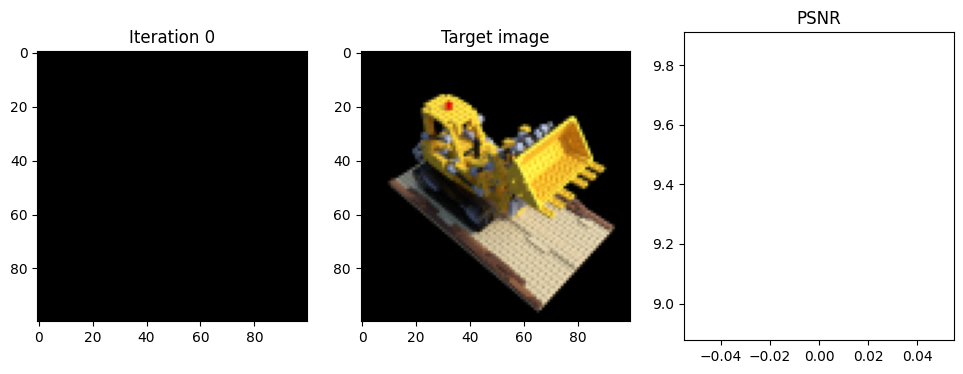

Iteration 25  Loss: 0.0960  PSNR: 10.18  Time: 0.27 secs per iter,  0.15 mins in total


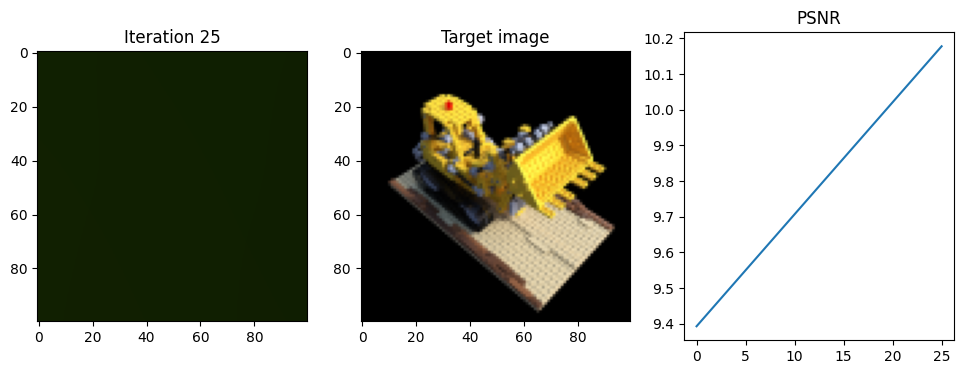

Iteration 50  Loss: 0.0843  PSNR: 10.74  Time: 0.27 secs per iter,  0.27 mins in total


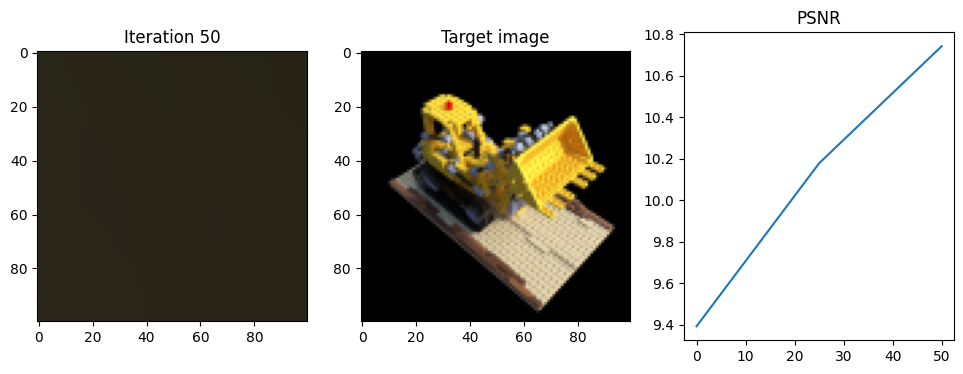

Iteration 75  Loss: 0.0848  PSNR: 10.72  Time: 0.27 secs per iter,  0.38 mins in total


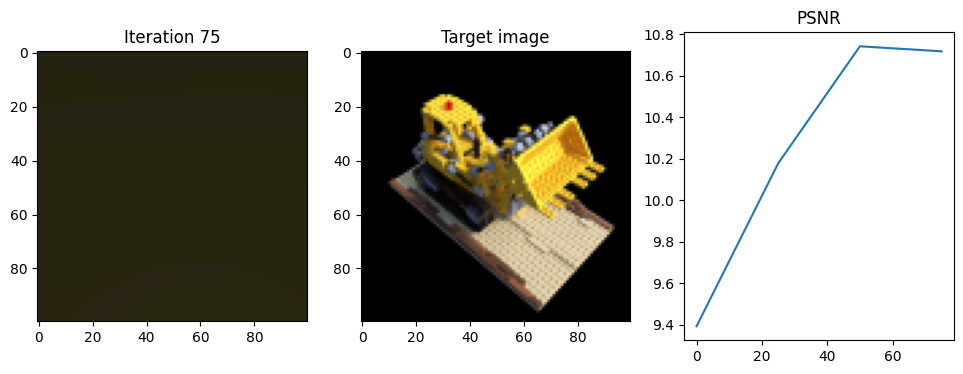

Iteration 100  Loss: 0.0866  PSNR: 10.63  Time: 0.27 secs per iter,  0.49 mins in total


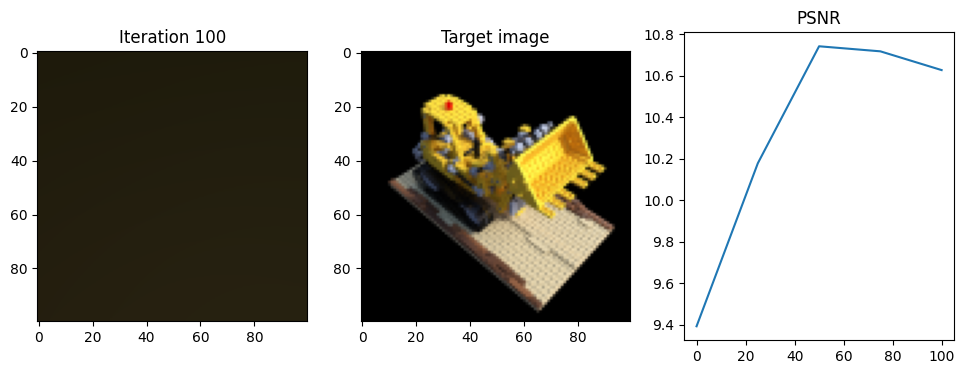

Iteration 125  Loss: 0.0806  PSNR: 10.94  Time: 0.28 secs per iter,  0.61 mins in total


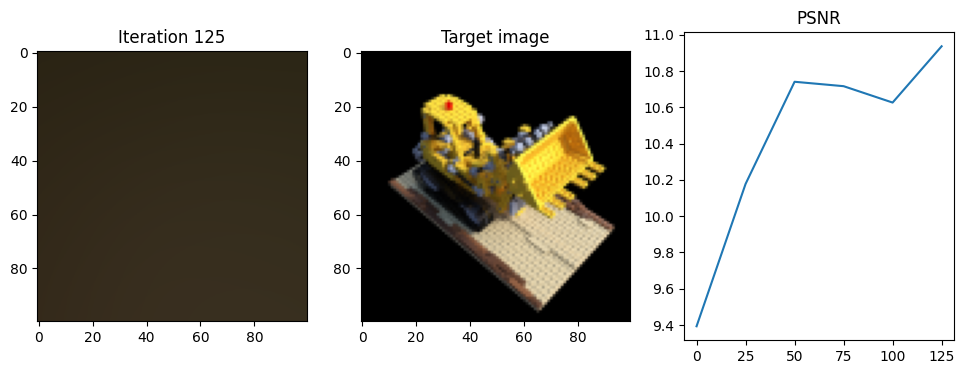

Iteration 150  Loss: 0.0818  PSNR: 10.87  Time: 0.28 secs per iter,  0.73 mins in total


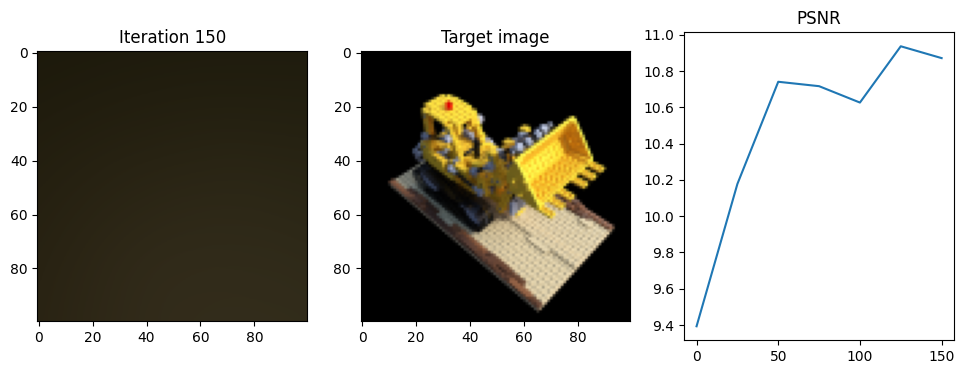

Iteration 175  Loss: 0.0785  PSNR: 11.05  Time: 0.28 secs per iter,  0.84 mins in total


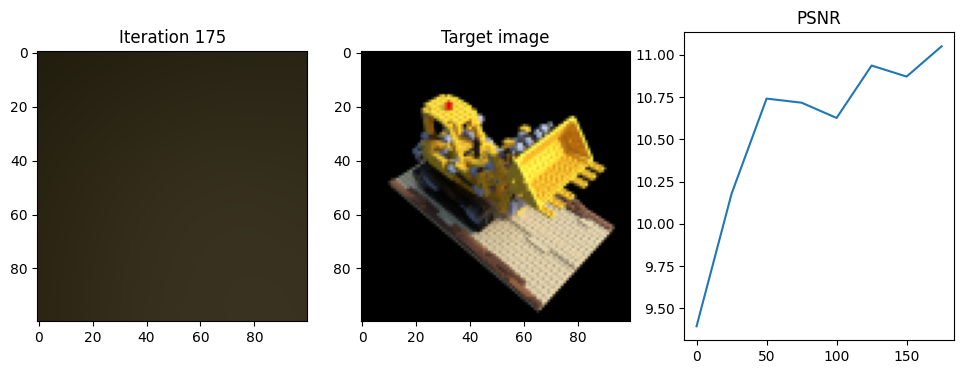

Iteration 200  Loss: 0.0762  PSNR: 11.18  Time: 0.27 secs per iter,  0.95 mins in total


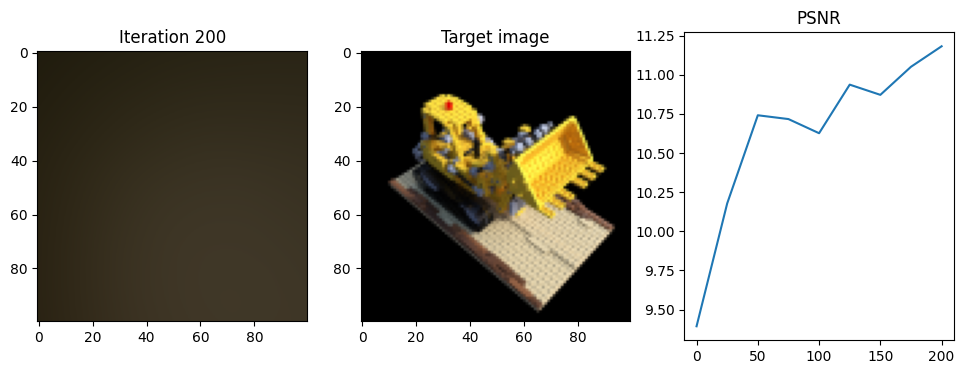

Iteration 225  Loss: 0.0718  PSNR: 11.44  Time: 0.27 secs per iter,  1.07 mins in total


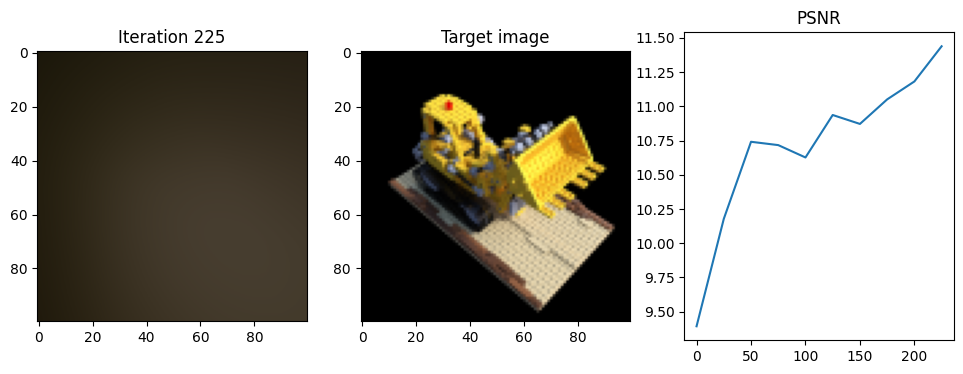

Iteration 250  Loss: 0.0768  PSNR: 11.14  Time: 0.28 secs per iter,  1.18 mins in total


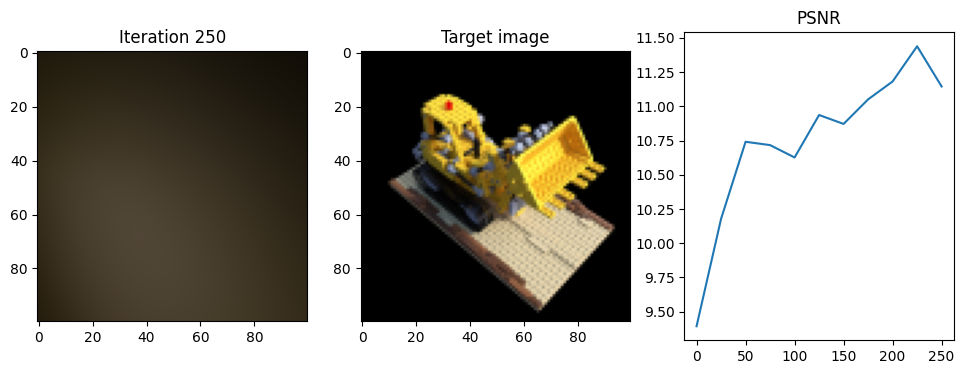

Iteration 275  Loss: 0.0678  PSNR: 11.69  Time: 0.28 secs per iter,  1.30 mins in total


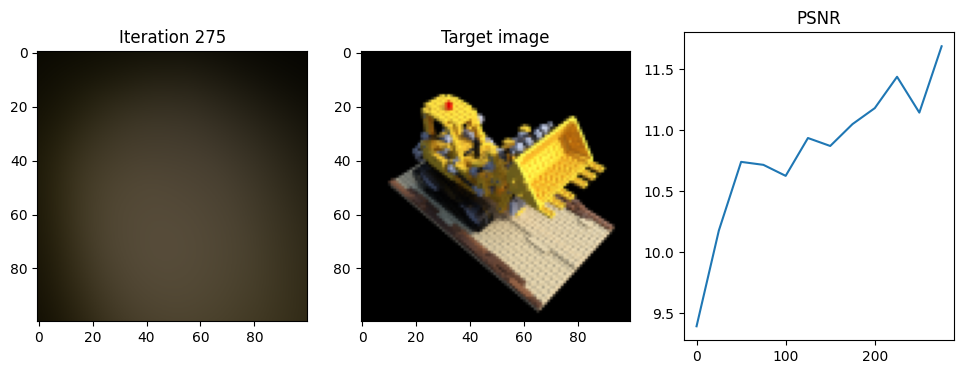

Iteration 300  Loss: 0.0529  PSNR: 12.76  Time: 0.27 secs per iter,  1.41 mins in total


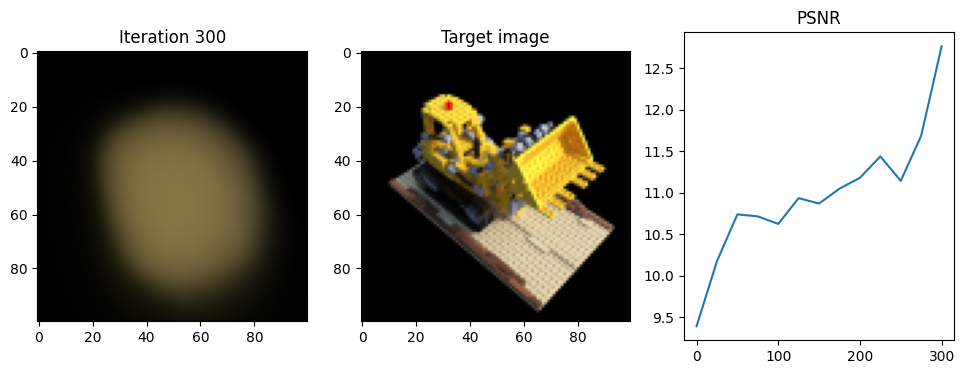

Iteration 325  Loss: 0.0440  PSNR: 13.56  Time: 0.28 secs per iter,  1.53 mins in total


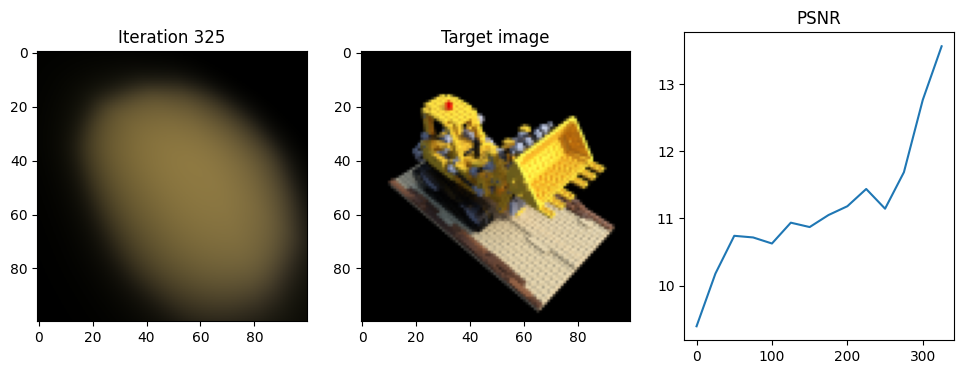

Iteration 350  Loss: 0.0468  PSNR: 13.30  Time: 0.28 secs per iter,  1.64 mins in total


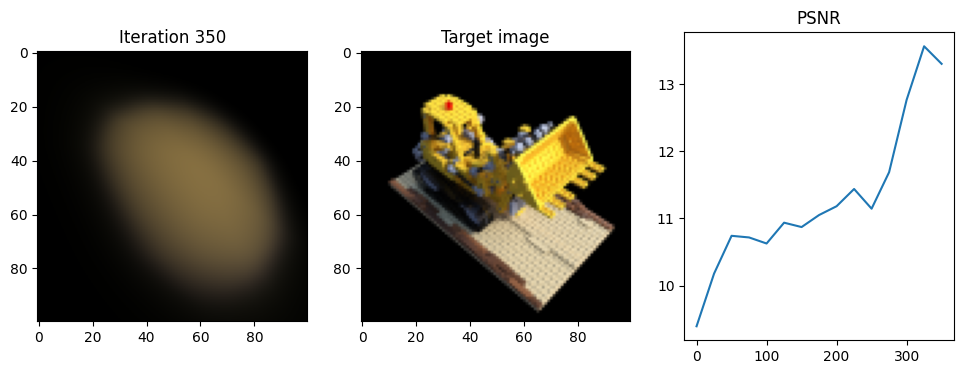

Iteration 375  Loss: 0.0428  PSNR: 13.68  Time: 0.27 secs per iter,  1.76 mins in total


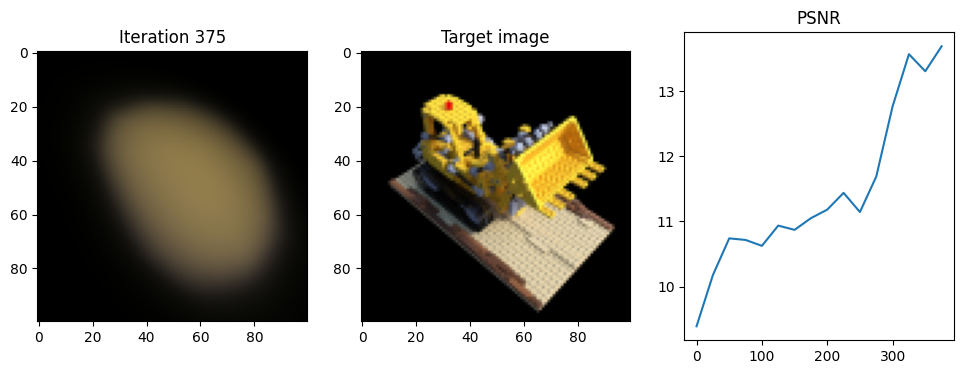

Iteration 400  Loss: 0.0389  PSNR: 14.10  Time: 0.27 secs per iter,  1.87 mins in total


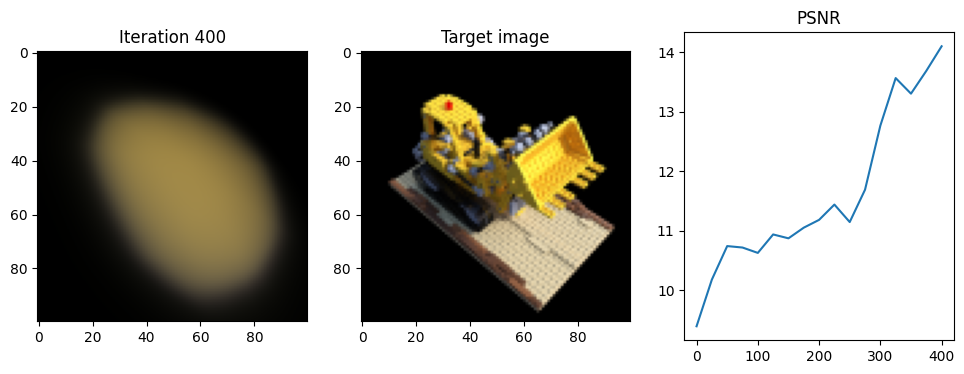

Iteration 425  Loss: 0.0376  PSNR: 14.24  Time: 0.27 secs per iter,  1.99 mins in total


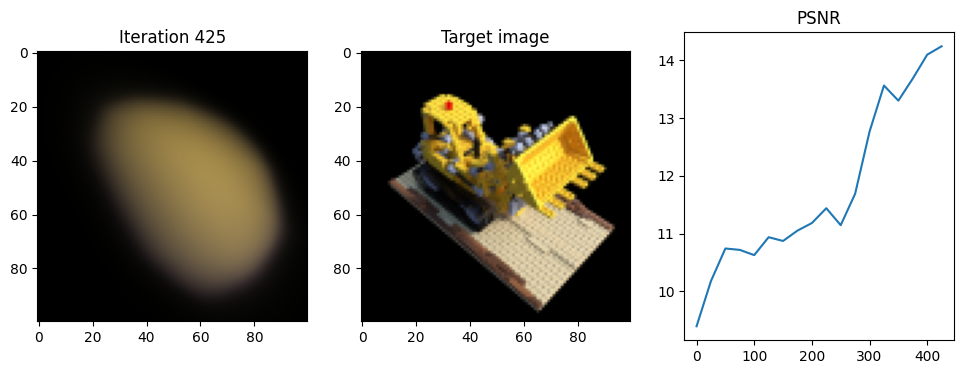

Iteration 450  Loss: 0.0388  PSNR: 14.11  Time: 0.27 secs per iter,  2.10 mins in total


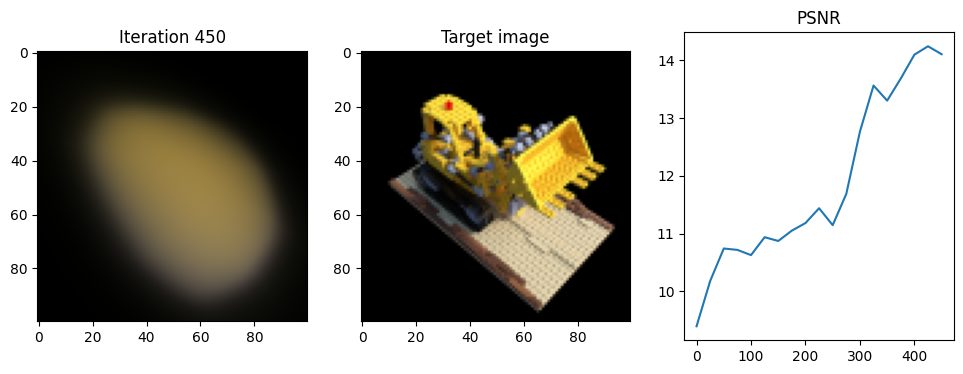

Iteration 475  Loss: 0.0377  PSNR: 14.24  Time: 0.27 secs per iter,  2.22 mins in total


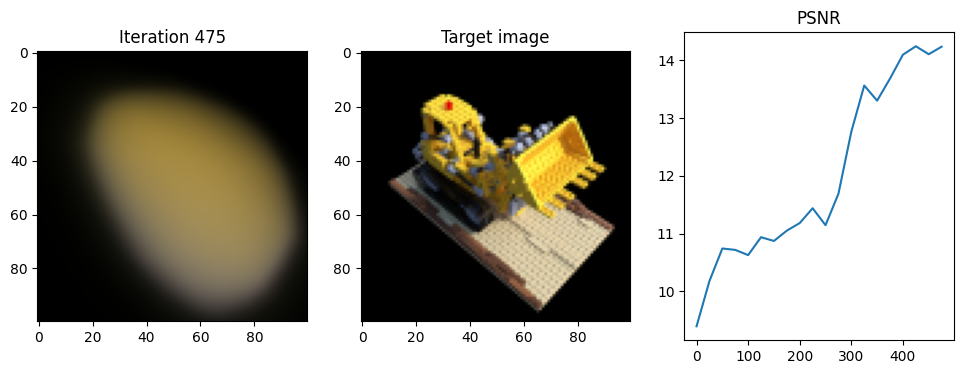

Iteration 500  Loss: 0.0387  PSNR: 14.12  Time: 0.27 secs per iter,  2.33 mins in total


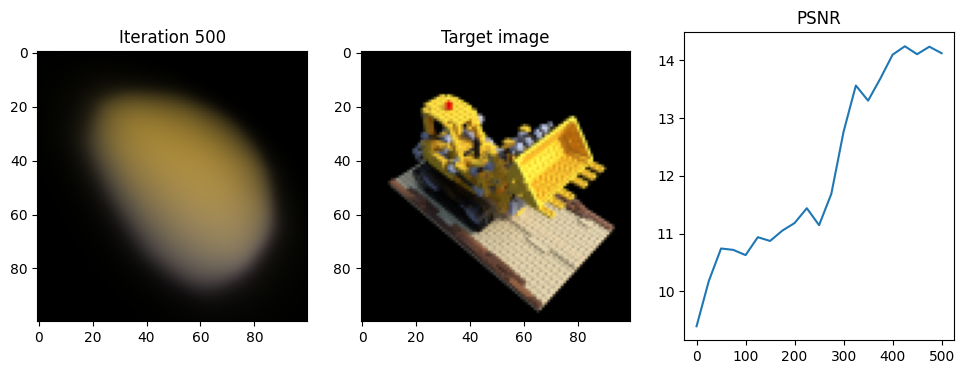

Iteration 525  Loss: 0.0397  PSNR: 14.01  Time: 0.28 secs per iter,  2.44 mins in total


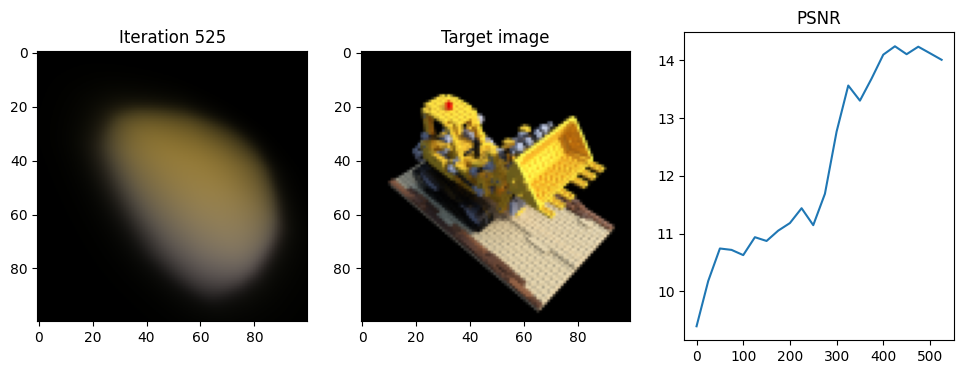

Iteration 550  Loss: 0.0428  PSNR: 13.69  Time: 0.28 secs per iter,  2.56 mins in total


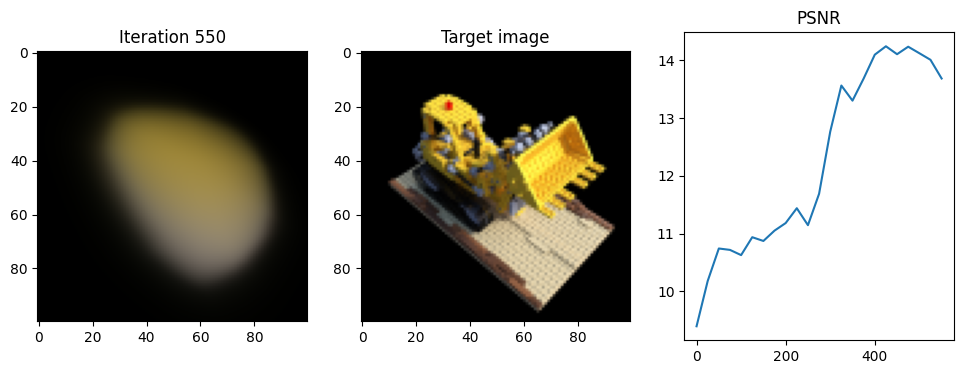

Iteration 575  Loss: 0.0315  PSNR: 15.02  Time: 0.27 secs per iter,  2.68 mins in total


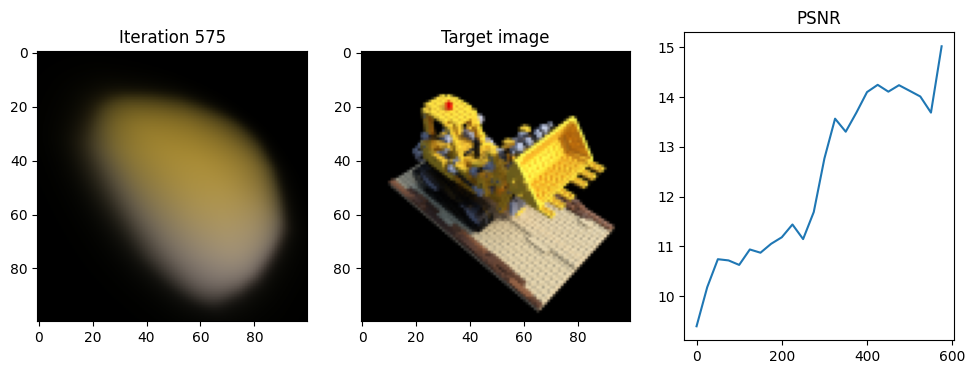

Iteration 600  Loss: 0.0329  PSNR: 14.83  Time: 0.27 secs per iter,  2.79 mins in total


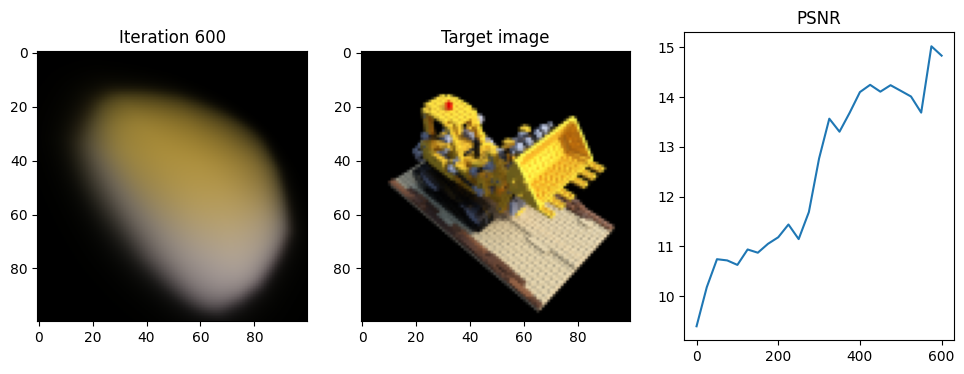

Iteration 625  Loss: 0.0377  PSNR: 14.23  Time: 0.27 secs per iter,  2.90 mins in total


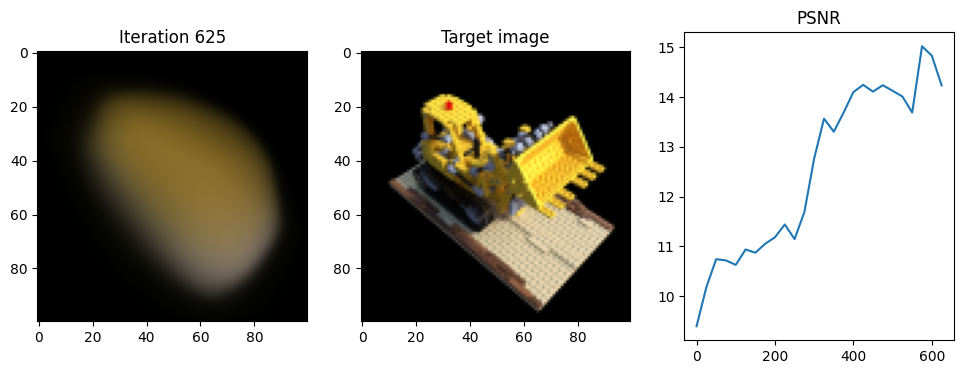

Iteration 650  Loss: 0.0326  PSNR: 14.86  Time: 0.27 secs per iter,  3.02 mins in total


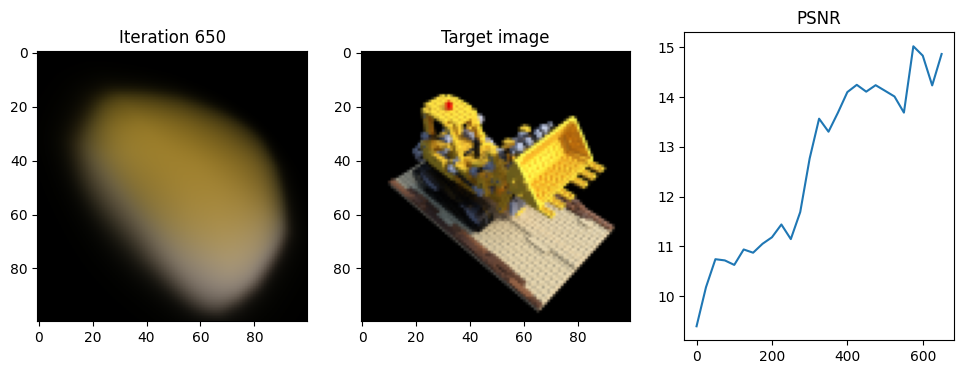

Iteration 675  Loss: 0.0298  PSNR: 15.26  Time: 0.28 secs per iter,  3.13 mins in total


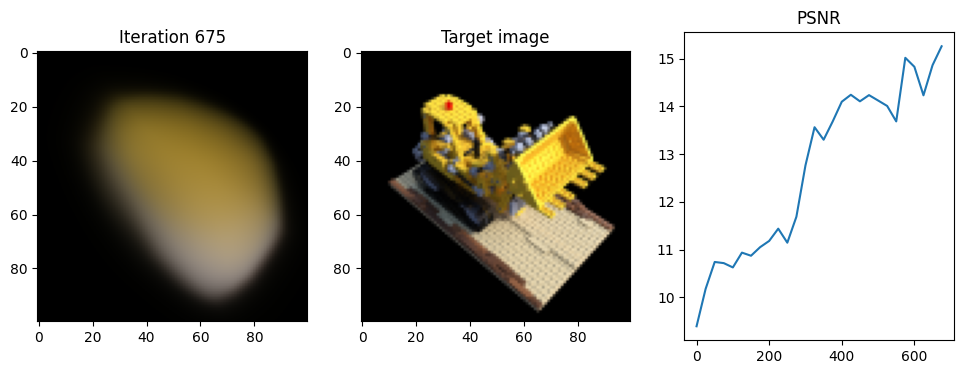

Iteration 700  Loss: 0.0275  PSNR: 15.61  Time: 0.27 secs per iter,  3.25 mins in total


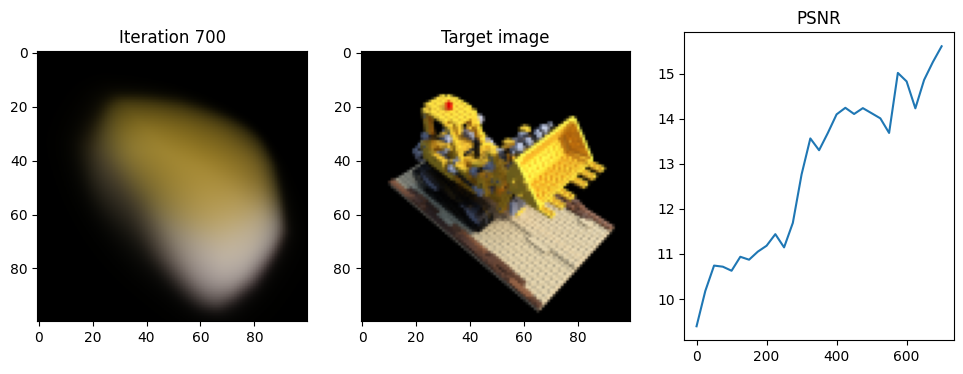

Iteration 725  Loss: 0.0285  PSNR: 15.45  Time: 0.28 secs per iter,  3.36 mins in total


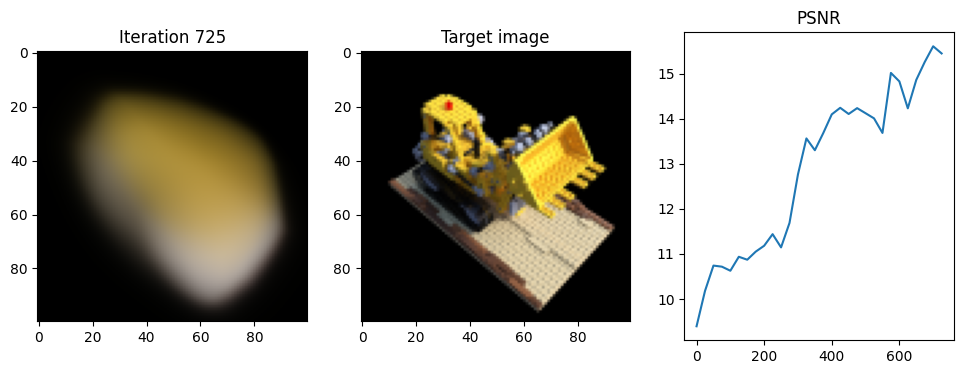

Iteration 750  Loss: 0.0275  PSNR: 15.60  Time: 0.28 secs per iter,  3.48 mins in total


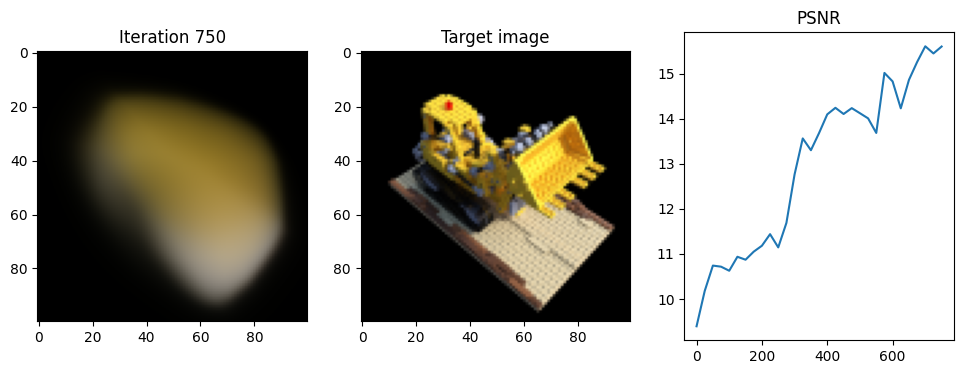

Iteration 775  Loss: 0.0337  PSNR: 14.72  Time: 0.27 secs per iter,  3.59 mins in total


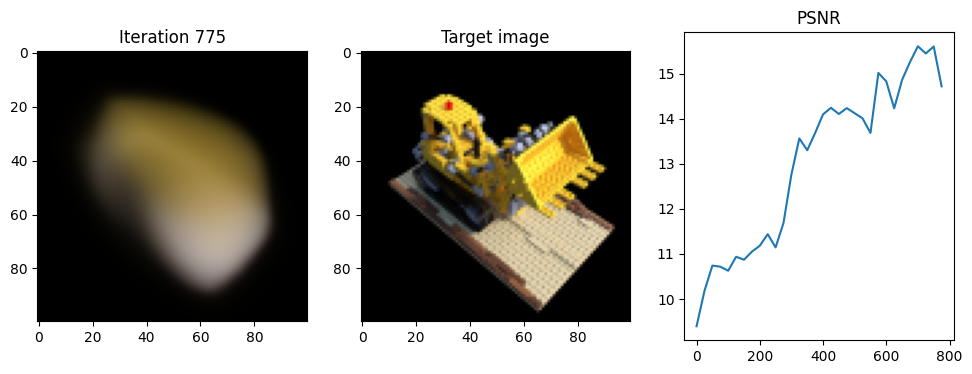

Iteration 800  Loss: 0.0291  PSNR: 15.36  Time: 0.27 secs per iter,  3.71 mins in total


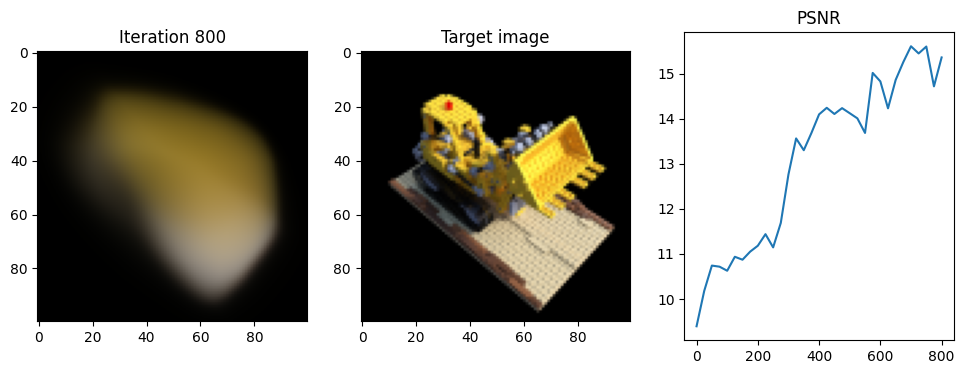

Iteration 825  Loss: 0.0269  PSNR: 15.69  Time: 0.27 secs per iter,  3.82 mins in total


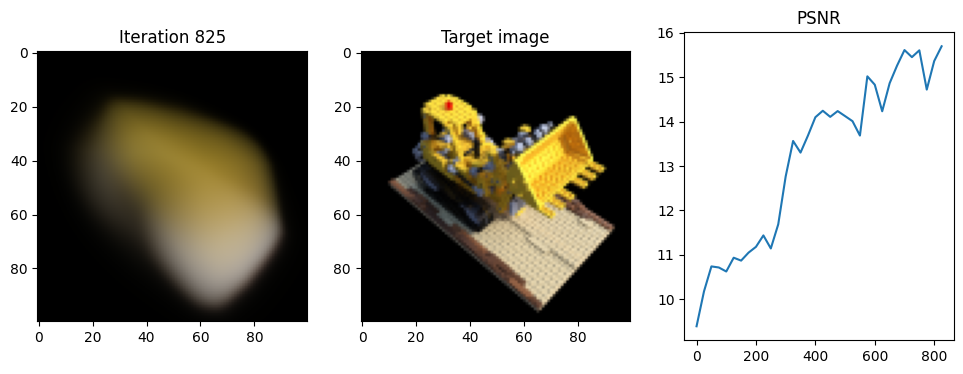

Iteration 850  Loss: 0.0240  PSNR: 16.20  Time: 0.27 secs per iter,  3.94 mins in total


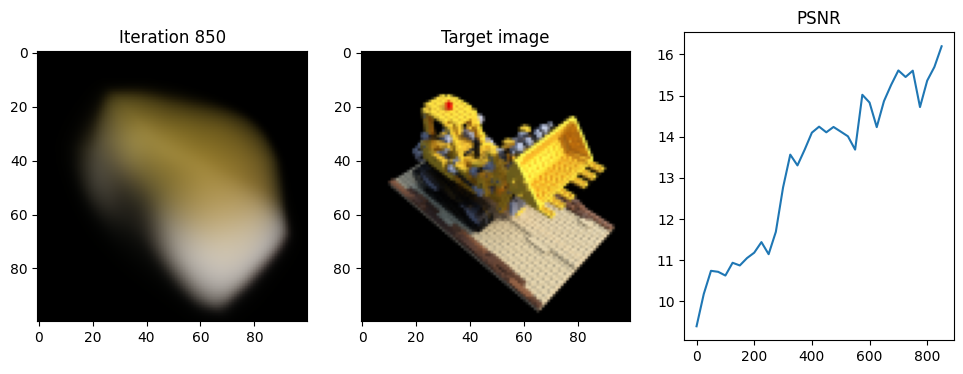

Iteration 875  Loss: 0.0300  PSNR: 15.23  Time: 0.27 secs per iter,  4.05 mins in total


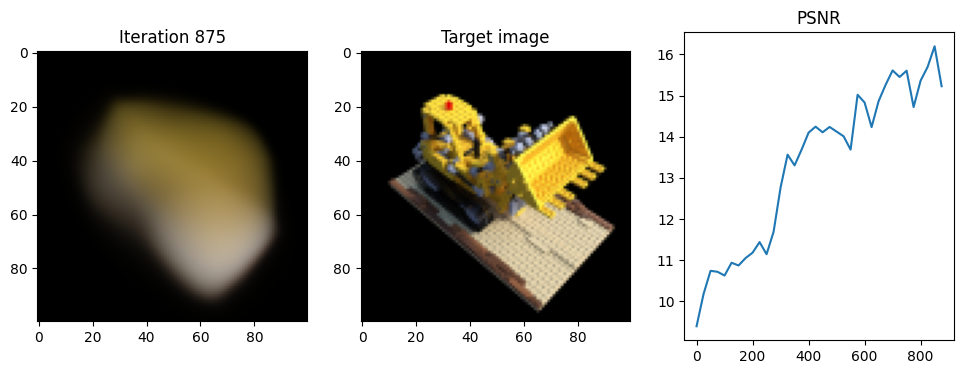

Iteration 900  Loss: 0.0239  PSNR: 16.22  Time: 0.27 secs per iter,  4.17 mins in total


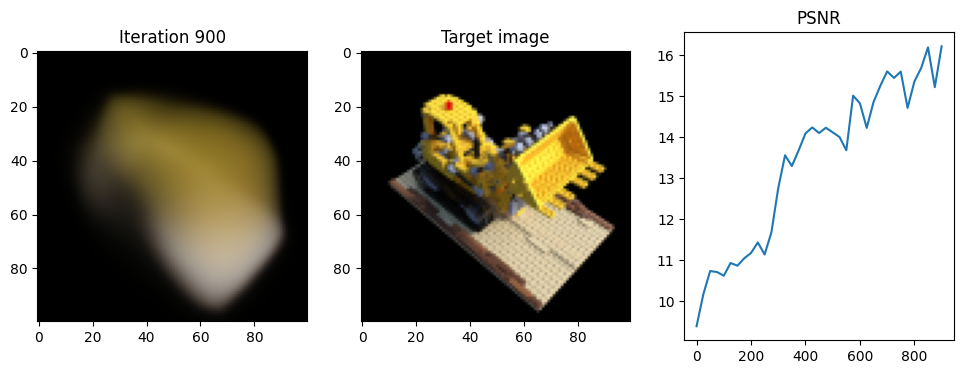

Iteration 925  Loss: 0.0292  PSNR: 15.34  Time: 0.28 secs per iter,  4.28 mins in total


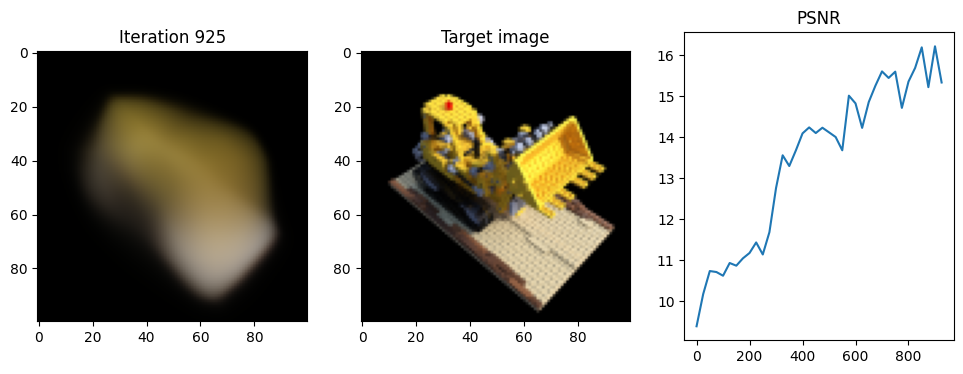

Iteration 950  Loss: 0.0227  PSNR: 16.44  Time: 0.27 secs per iter,  4.40 mins in total


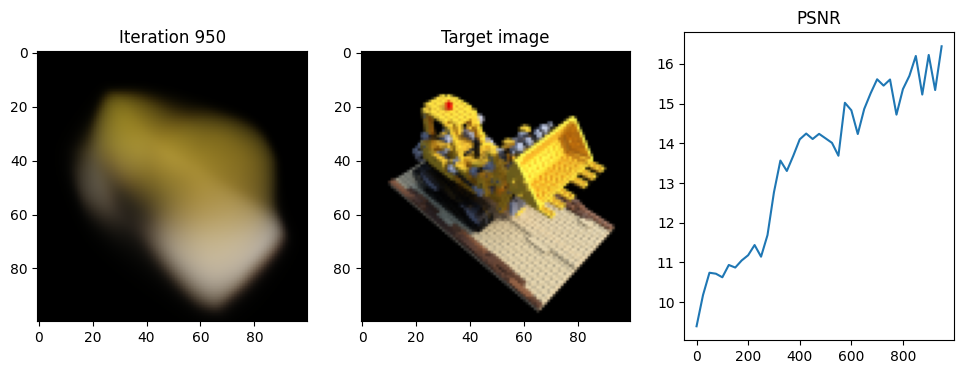

Iteration 975  Loss: 0.0249  PSNR: 16.04  Time: 0.27 secs per iter,  4.51 mins in total


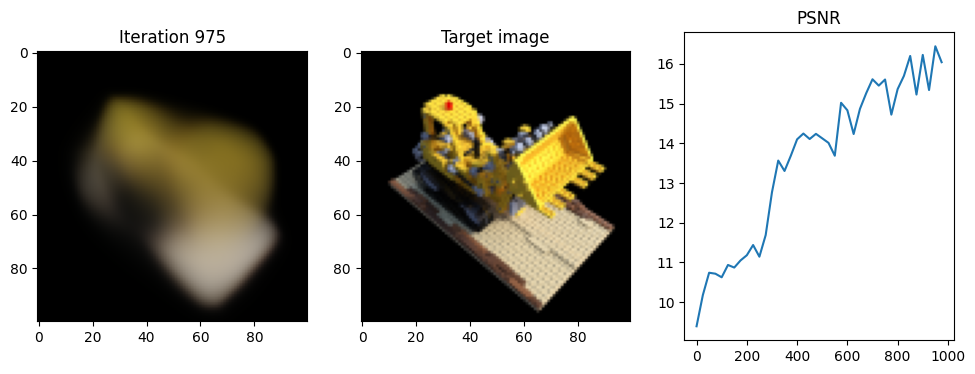

Iteration 1000  Loss: 0.0205  PSNR: 16.87  Time: 0.27 secs per iter,  4.62 mins in total


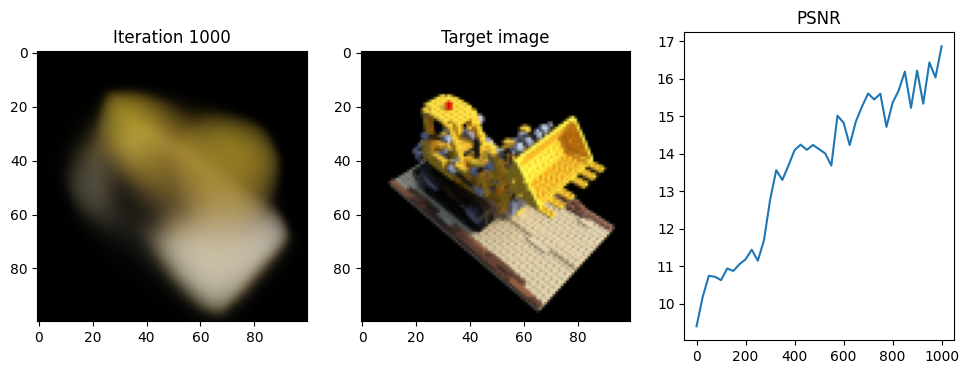

Iteration 1025  Loss: 0.0186  PSNR: 17.30  Time: 0.27 secs per iter,  4.74 mins in total


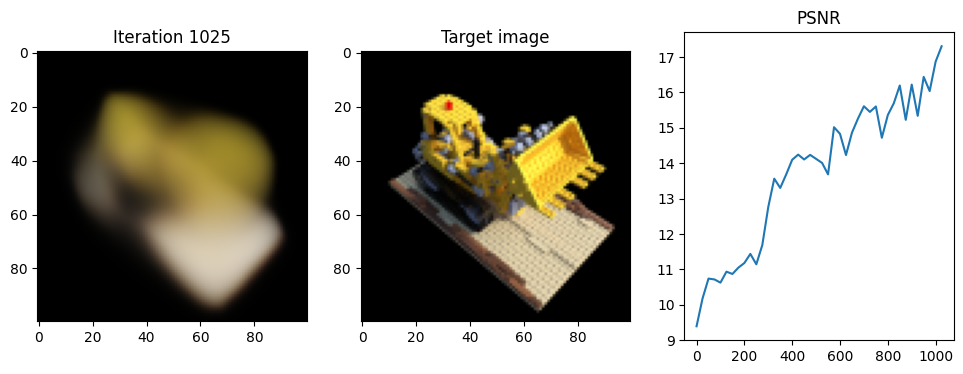

Iteration 1050  Loss: 0.0188  PSNR: 17.26  Time: 0.27 secs per iter,  4.85 mins in total


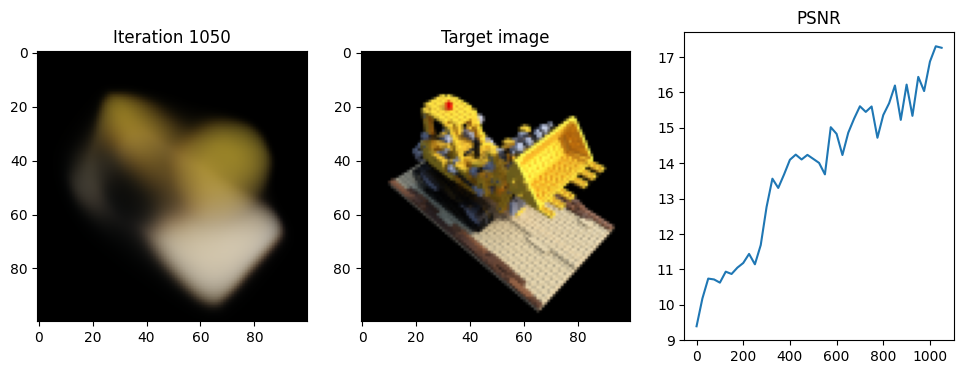

Iteration 1075  Loss: 0.0222  PSNR: 16.54  Time: 0.27 secs per iter,  4.97 mins in total


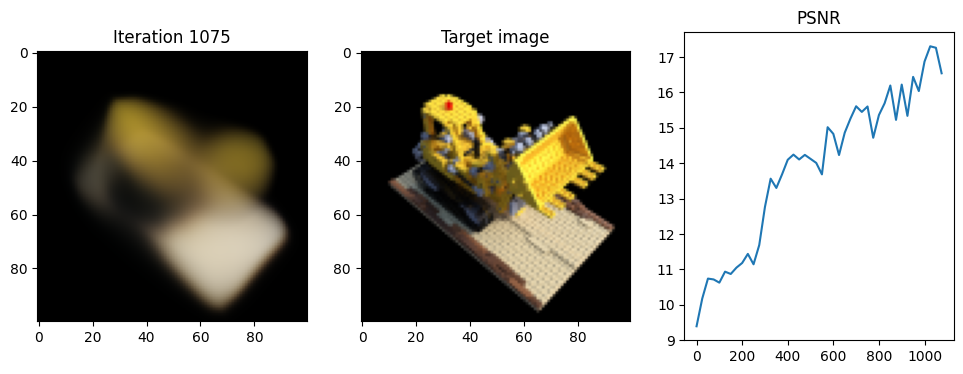

Iteration 1100  Loss: 0.0211  PSNR: 16.76  Time: 0.28 secs per iter,  5.08 mins in total


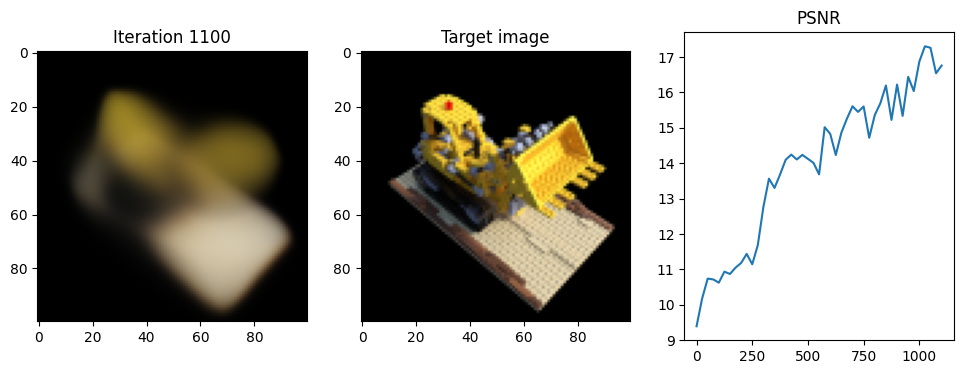

Iteration 1125  Loss: 0.0277  PSNR: 15.58  Time: 0.28 secs per iter,  5.20 mins in total


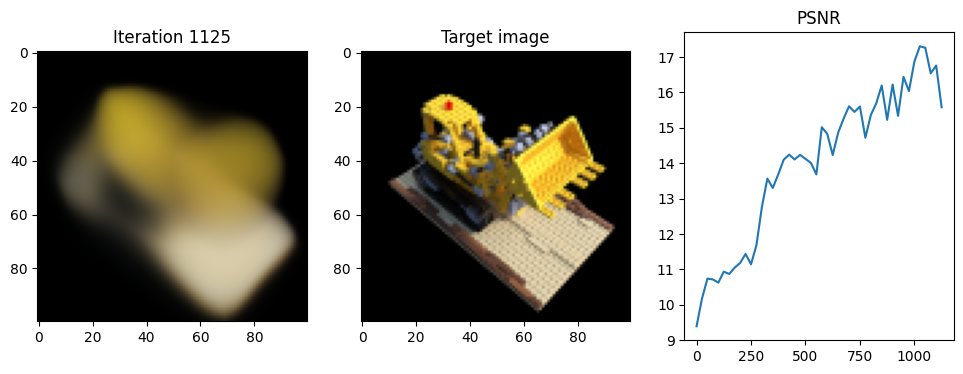

Iteration 1150  Loss: 0.0209  PSNR: 16.80  Time: 0.27 secs per iter,  5.31 mins in total


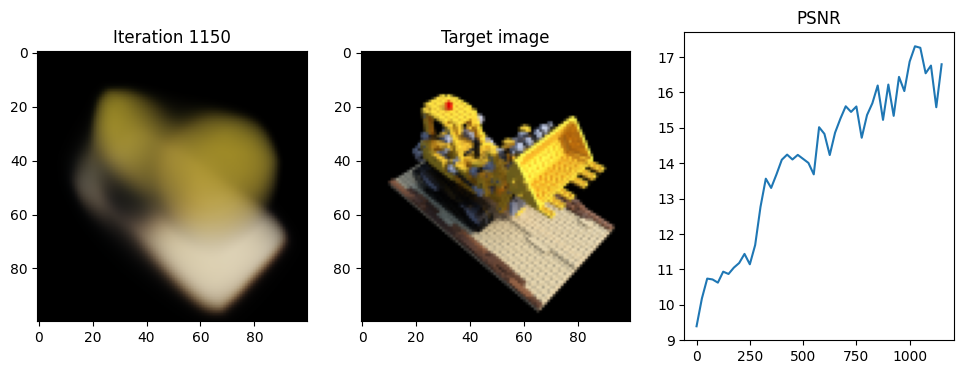

Iteration 1175  Loss: 0.0207  PSNR: 16.85  Time: 0.27 secs per iter,  5.43 mins in total


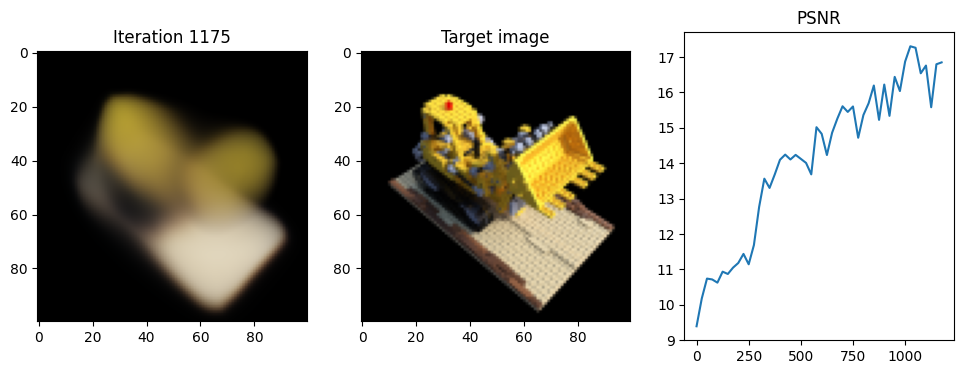

Iteration 1200  Loss: 0.0224  PSNR: 16.50  Time: 0.27 secs per iter,  5.54 mins in total


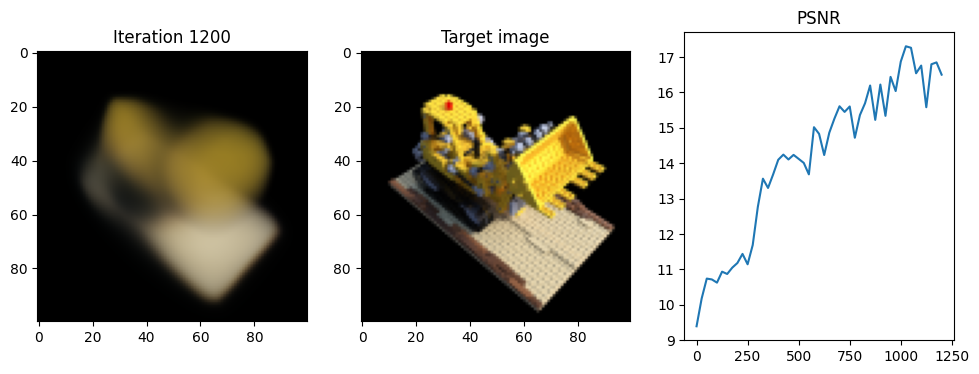

Iteration 1225  Loss: 0.0185  PSNR: 17.33  Time: 0.27 secs per iter,  5.66 mins in total


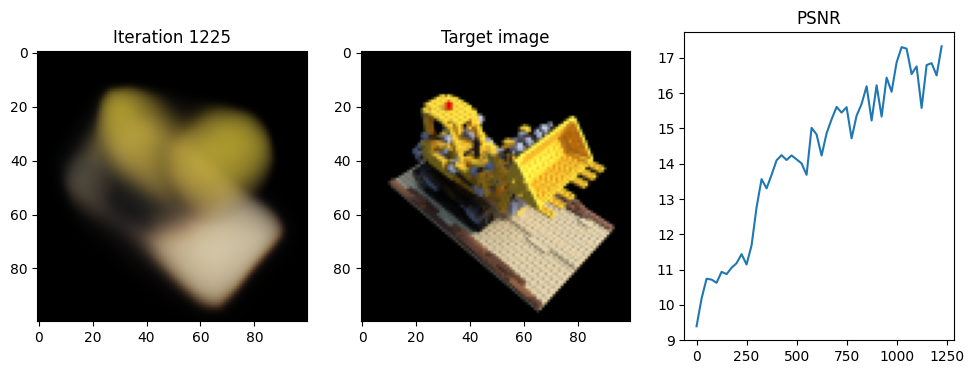

Iteration 1250  Loss: 0.0182  PSNR: 17.41  Time: 0.27 secs per iter,  5.77 mins in total


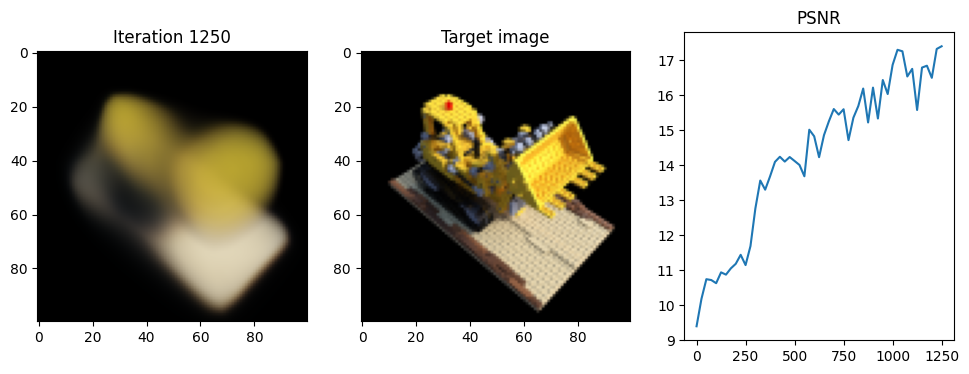

Iteration 1275  Loss: 0.0191  PSNR: 17.20  Time: 0.27 secs per iter,  5.89 mins in total


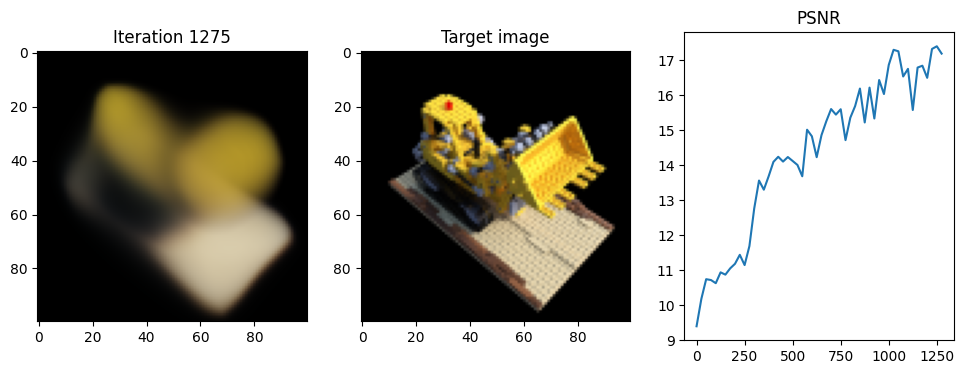

Iteration 1300  Loss: 0.0158  PSNR: 18.02  Time: 0.28 secs per iter,  6.00 mins in total


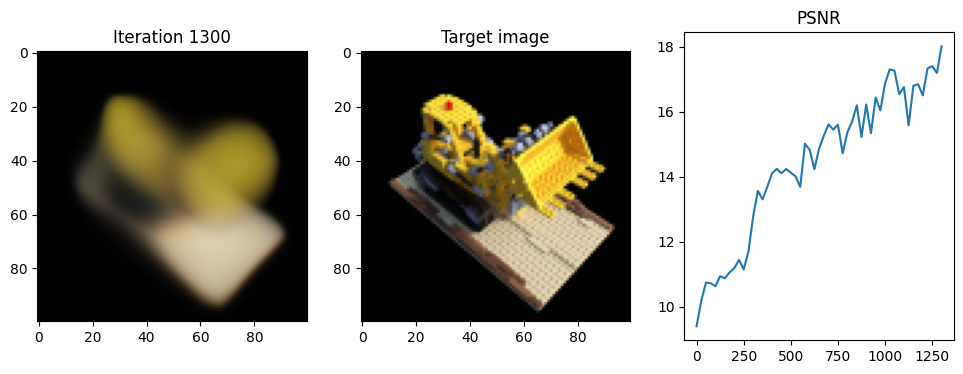

Iteration 1325  Loss: 0.0164  PSNR: 17.84  Time: 0.27 secs per iter,  6.12 mins in total


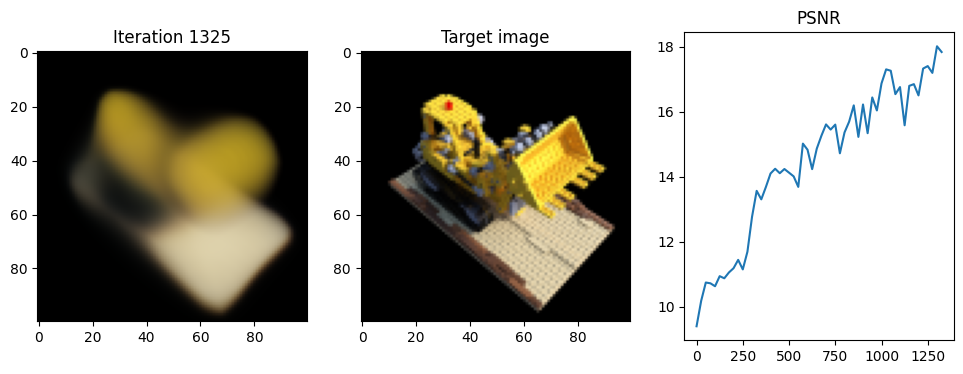

Iteration 1350  Loss: 0.0183  PSNR: 17.38  Time: 0.27 secs per iter,  6.23 mins in total


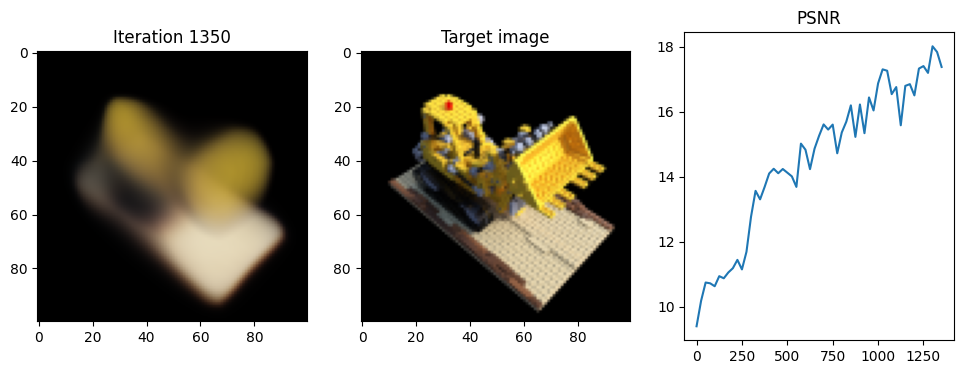

Iteration 1375  Loss: 0.0171  PSNR: 17.68  Time: 0.27 secs per iter,  6.35 mins in total


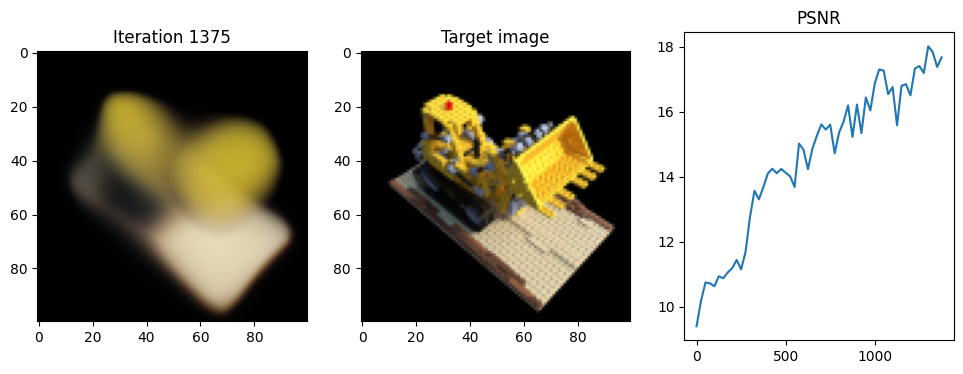

Iteration 1400  Loss: 0.0157  PSNR: 18.03  Time: 0.27 secs per iter,  6.46 mins in total


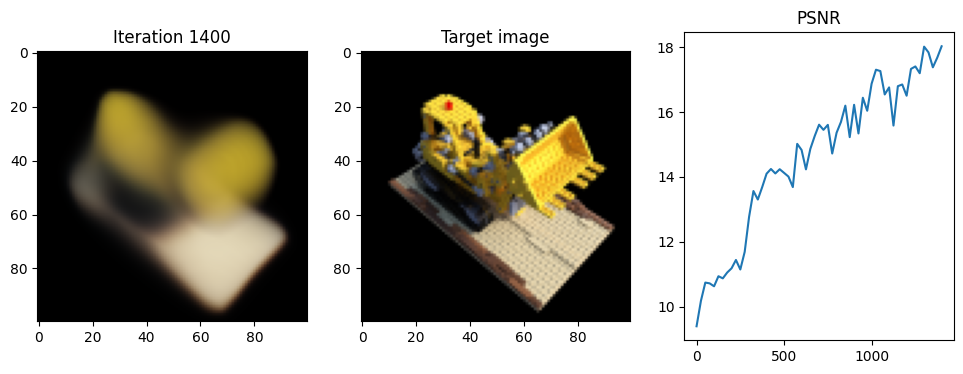

Iteration 1425  Loss: 0.0152  PSNR: 18.19  Time: 0.27 secs per iter,  6.57 mins in total


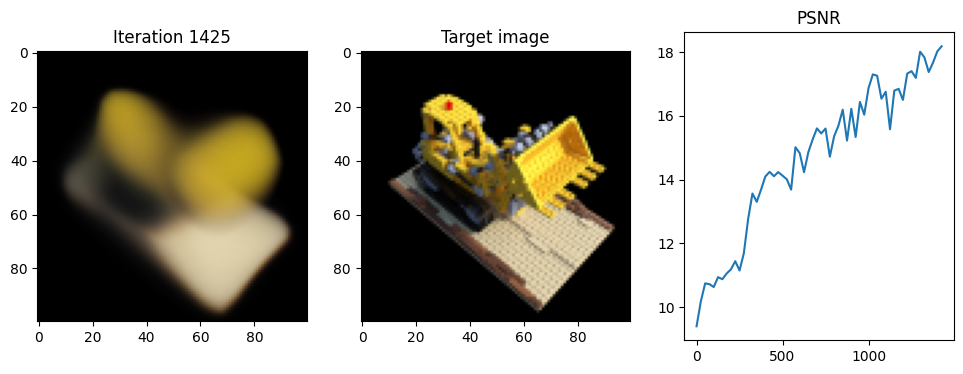

Iteration 1450  Loss: 0.0151  PSNR: 18.20  Time: 0.27 secs per iter,  6.69 mins in total


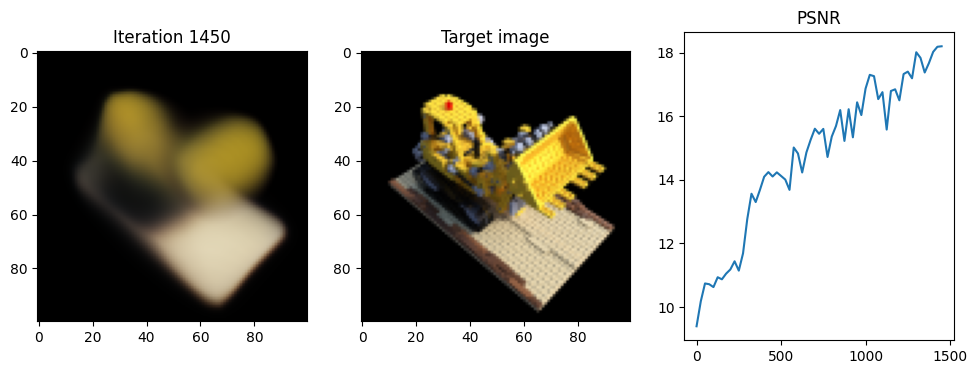

Iteration 1475  Loss: 0.0218  PSNR: 16.61  Time: 0.27 secs per iter,  6.80 mins in total


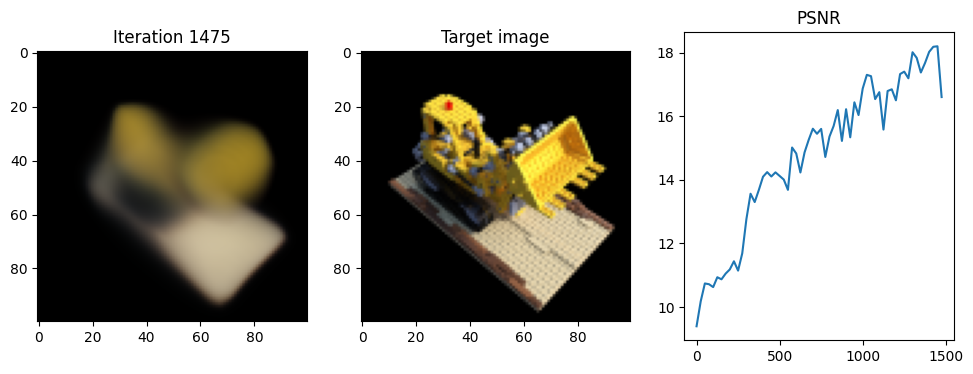

Iteration 1500  Loss: 0.0155  PSNR: 18.08  Time: 0.28 secs per iter,  6.92 mins in total


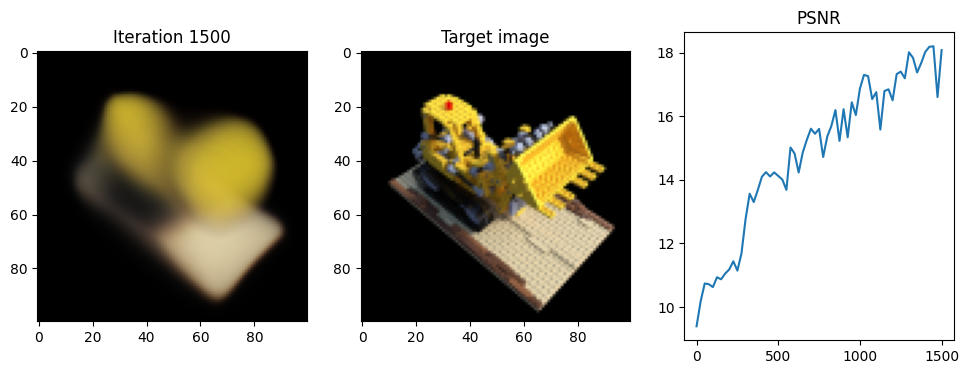

Iteration 1525  Loss: 0.0156  PSNR: 18.07  Time: 0.27 secs per iter,  7.03 mins in total


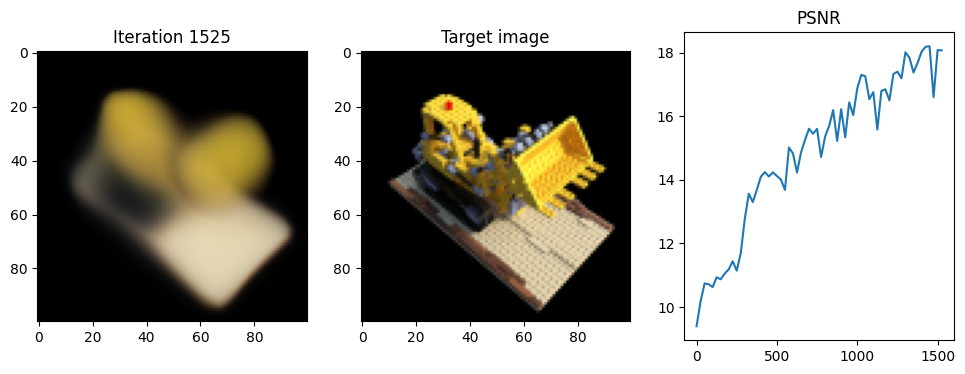

Iteration 1550  Loss: 0.0175  PSNR: 17.58  Time: 0.27 secs per iter,  7.15 mins in total


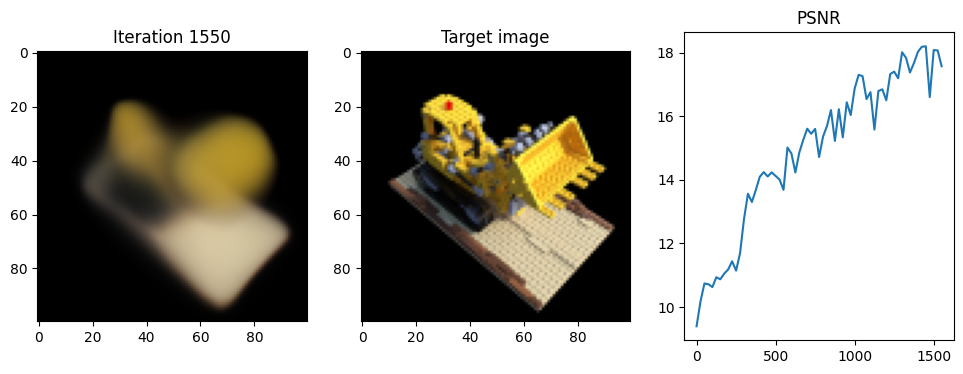

Iteration 1575  Loss: 0.0142  PSNR: 18.48  Time: 0.27 secs per iter,  7.26 mins in total


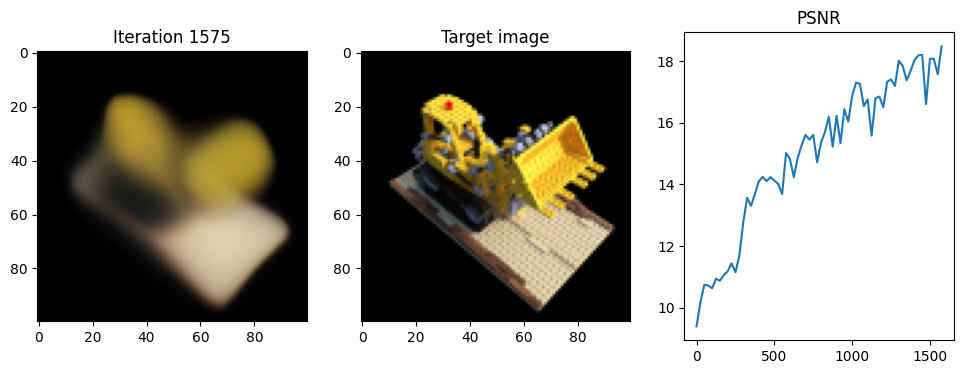

Iteration 1600  Loss: 0.0136  PSNR: 18.67  Time: 0.27 secs per iter,  7.37 mins in total


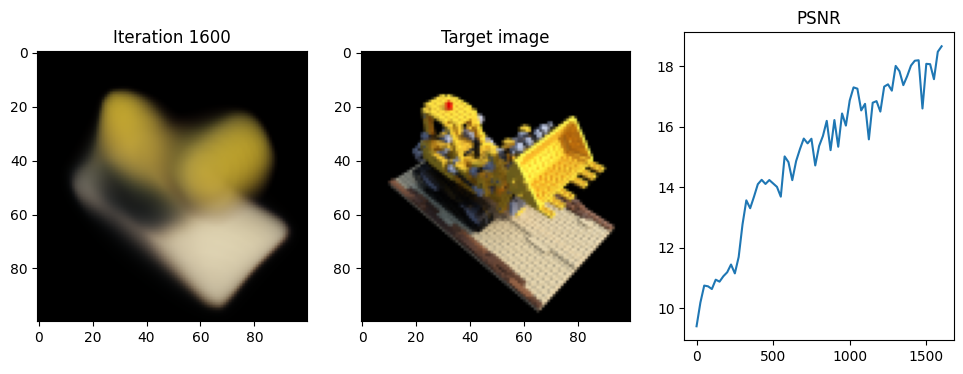

Iteration 1625  Loss: 0.0148  PSNR: 18.30  Time: 0.27 secs per iter,  7.49 mins in total


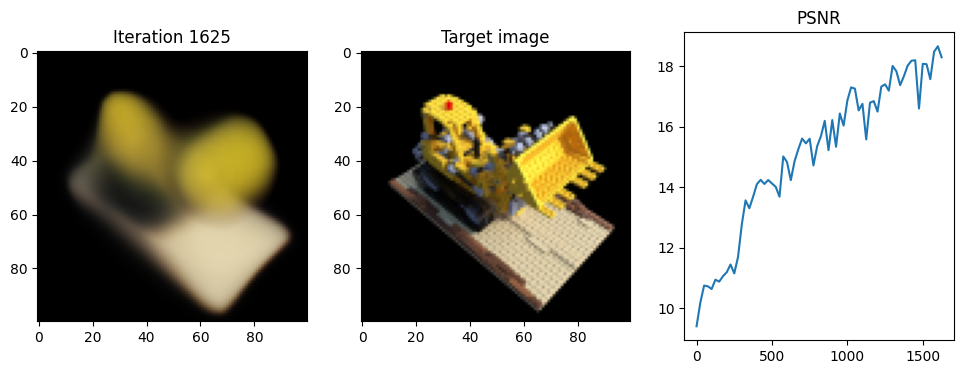

Iteration 1650  Loss: 0.0131  PSNR: 18.83  Time: 0.27 secs per iter,  7.60 mins in total


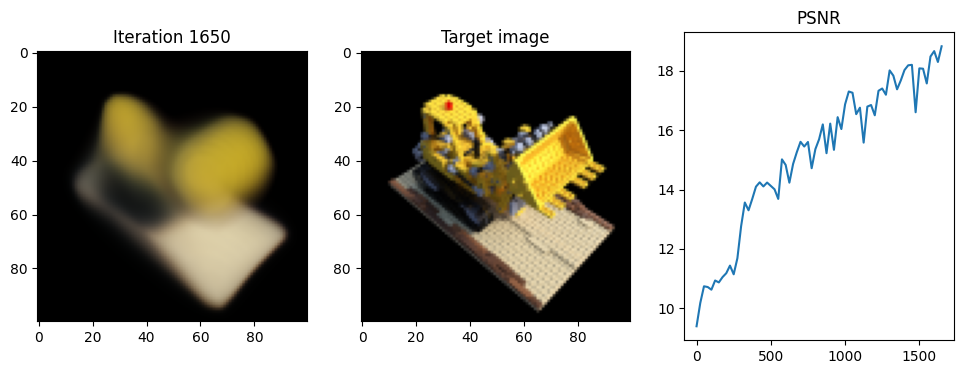

Iteration 1675  Loss: 0.0145  PSNR: 18.37  Time: 0.27 secs per iter,  7.72 mins in total


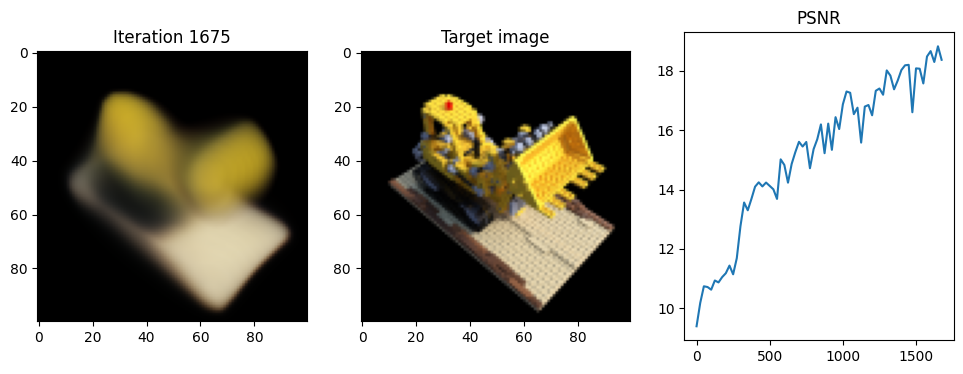

Iteration 1700  Loss: 0.0144  PSNR: 18.42  Time: 0.28 secs per iter,  7.83 mins in total


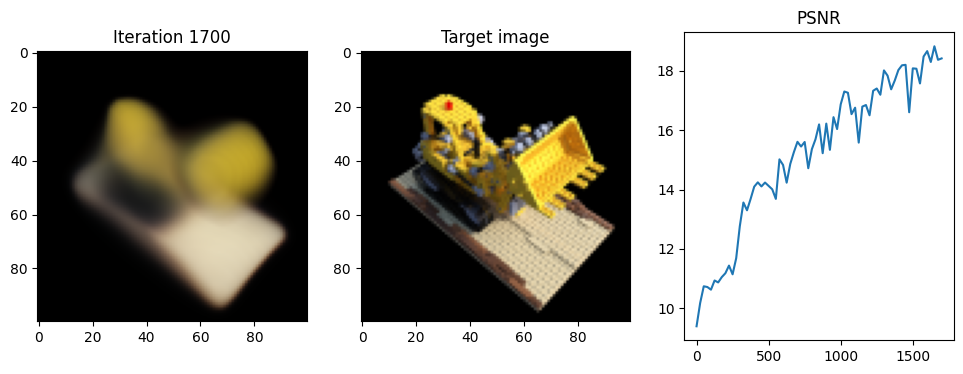

Iteration 1725  Loss: 0.0281  PSNR: 15.52  Time: 0.27 secs per iter,  7.95 mins in total


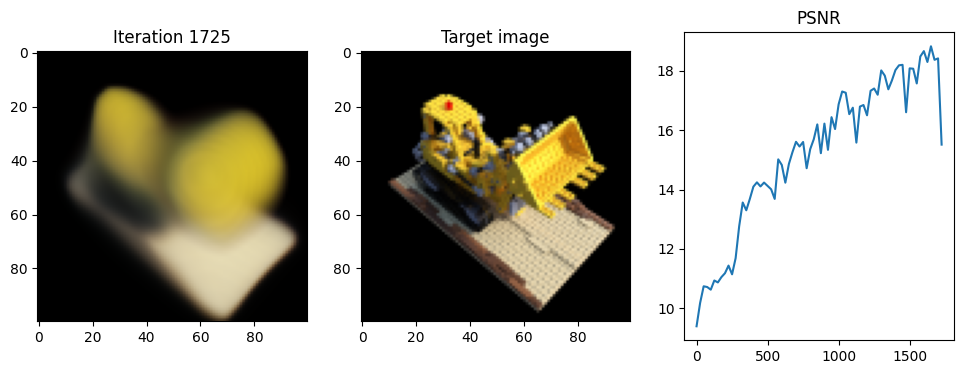

Iteration 1750  Loss: 0.0150  PSNR: 18.23  Time: 0.27 secs per iter,  8.06 mins in total


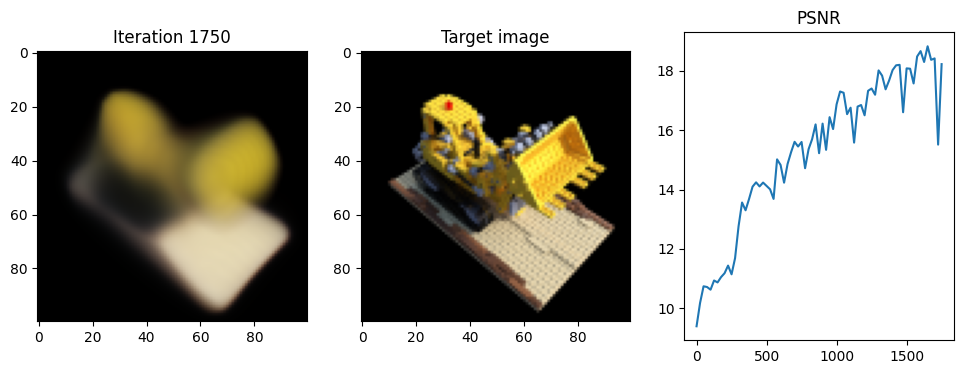

Iteration 1775  Loss: 0.0127  PSNR: 18.95  Time: 0.27 secs per iter,  8.17 mins in total


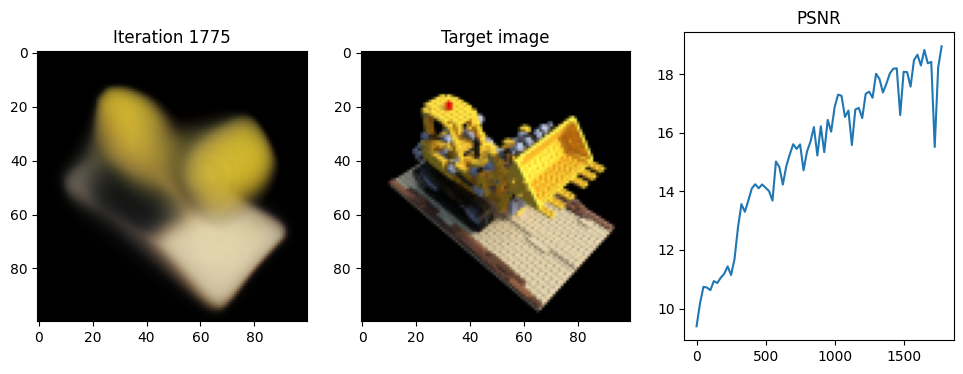

Iteration 1800  Loss: 0.0142  PSNR: 18.47  Time: 0.27 secs per iter,  8.29 mins in total


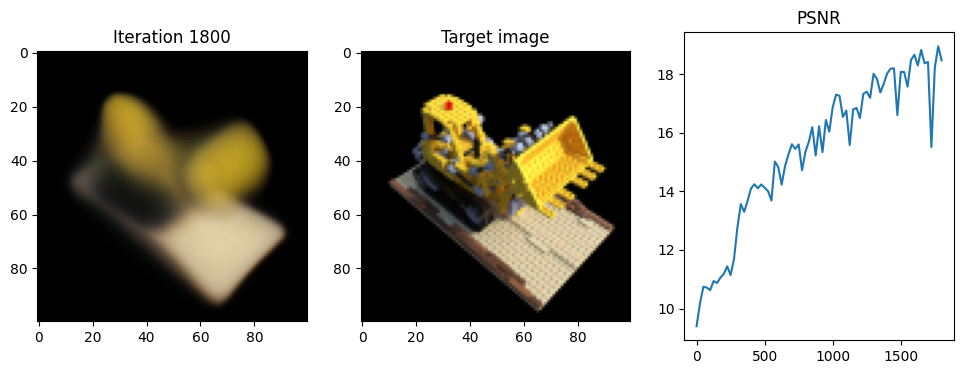

Iteration 1825  Loss: 0.0145  PSNR: 18.40  Time: 0.27 secs per iter,  8.40 mins in total


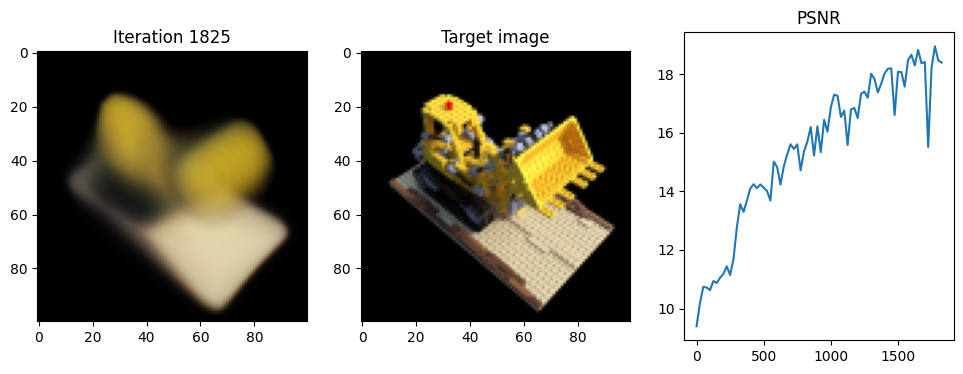

Iteration 1850  Loss: 0.0123  PSNR: 19.10  Time: 0.27 secs per iter,  8.52 mins in total


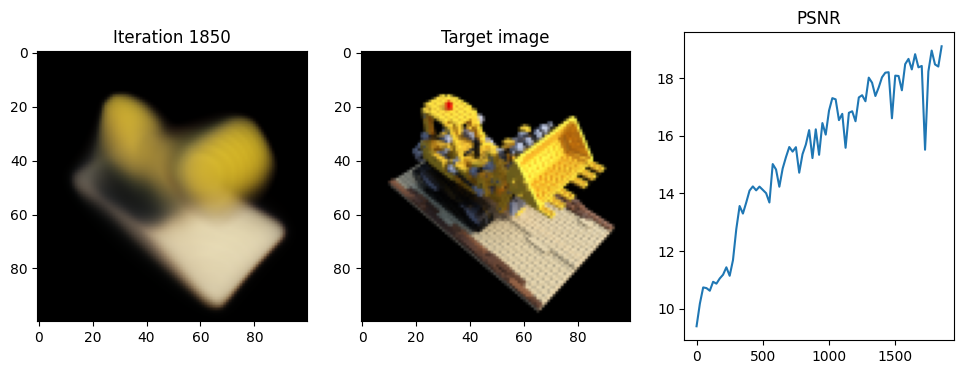

Iteration 1875  Loss: 0.0129  PSNR: 18.88  Time: 0.27 secs per iter,  8.63 mins in total


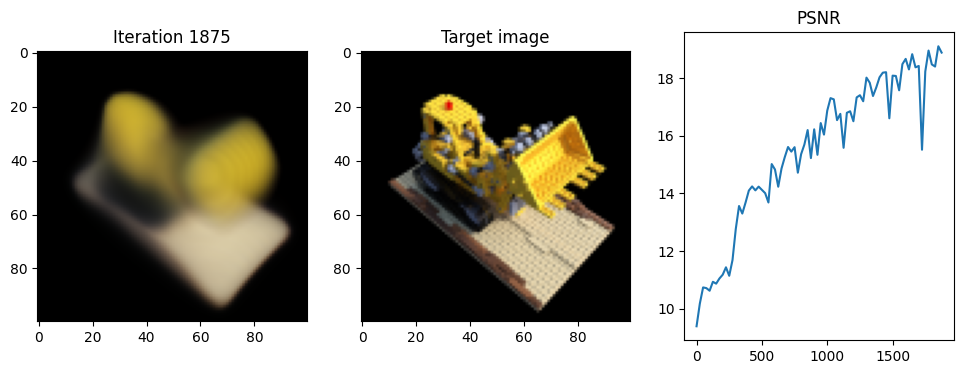

Iteration 1900  Loss: 0.0116  PSNR: 19.34  Time: 0.28 secs per iter,  8.75 mins in total


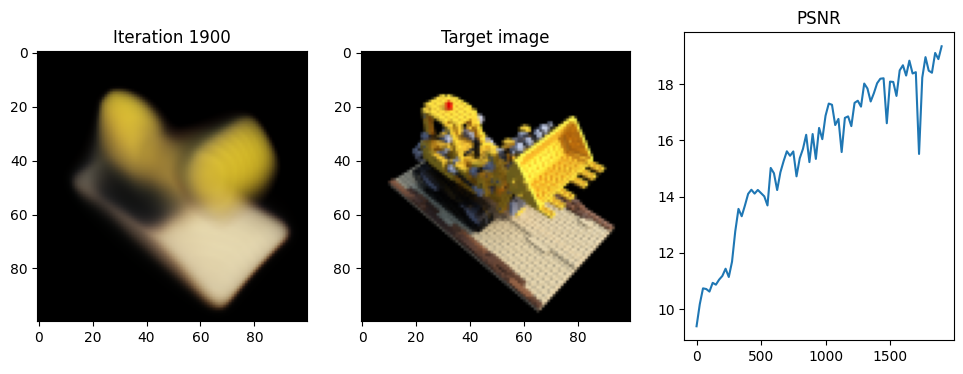

Iteration 1925  Loss: 0.0142  PSNR: 18.47  Time: 0.27 secs per iter,  8.86 mins in total


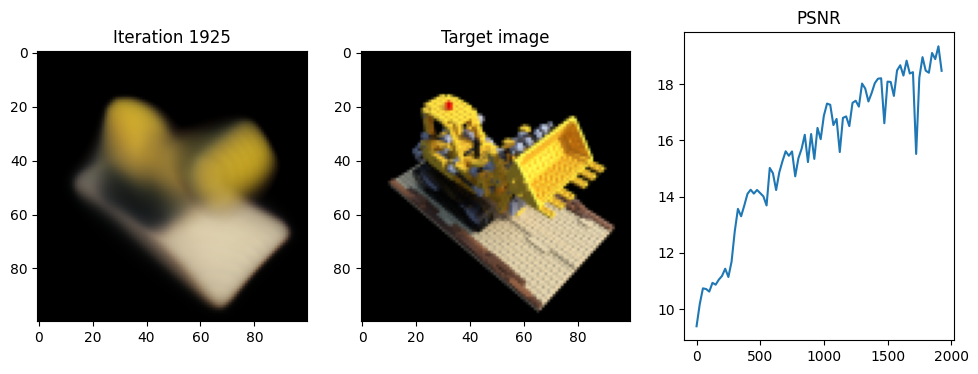

Iteration 1950  Loss: 0.0119  PSNR: 19.25  Time: 0.27 secs per iter,  8.97 mins in total


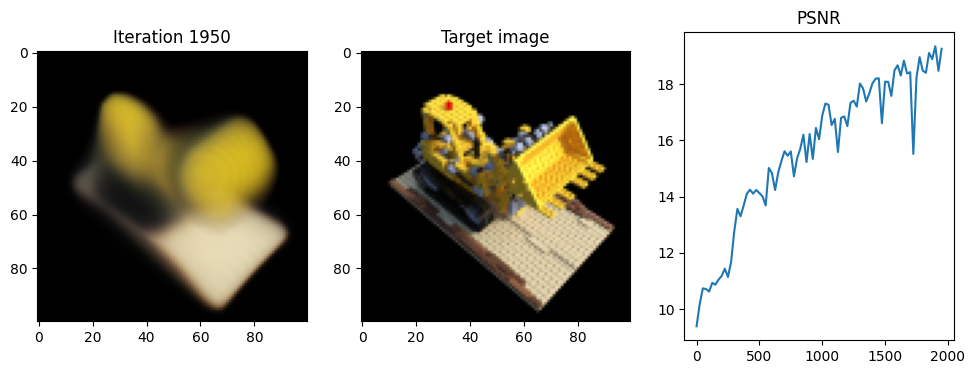

Iteration 1975  Loss: 0.0112  PSNR: 19.49  Time: 0.27 secs per iter,  9.09 mins in total


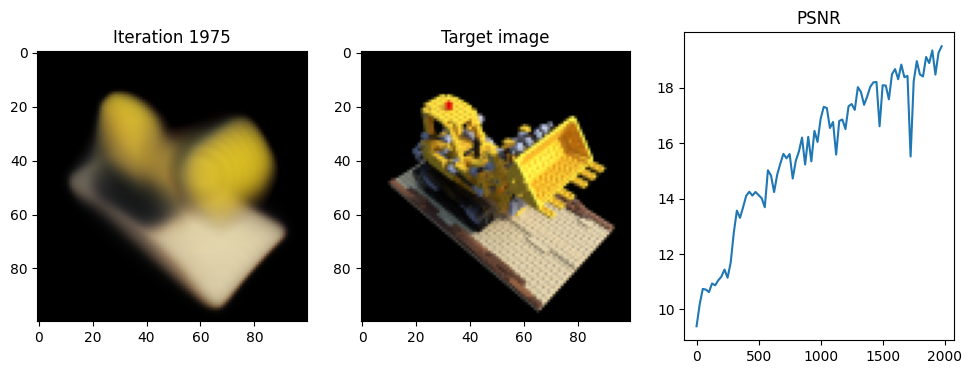

Iteration 2000  Loss: 0.0135  PSNR: 18.69  Time: 0.27 secs per iter,  9.20 mins in total


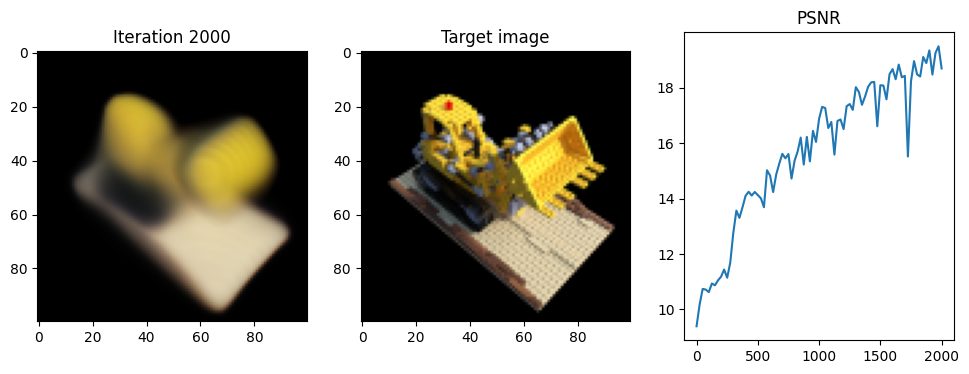

Iteration 2025  Loss: 0.0148  PSNR: 18.29  Time: 0.27 secs per iter,  9.32 mins in total


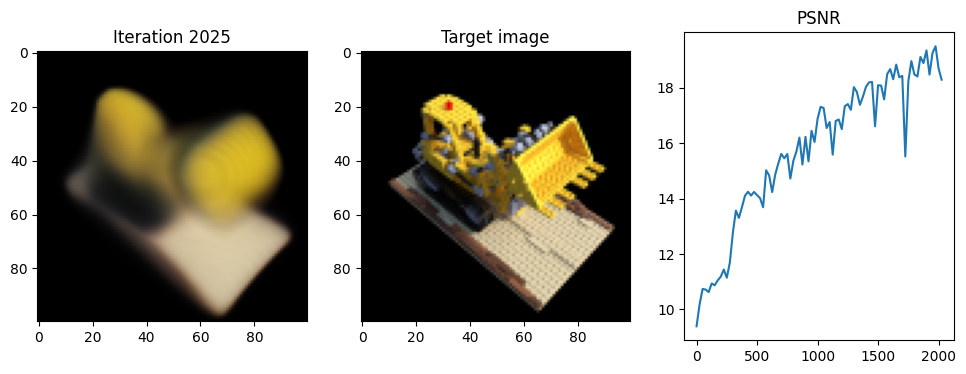

Iteration 2050  Loss: 0.0139  PSNR: 18.56  Time: 0.27 secs per iter,  9.43 mins in total


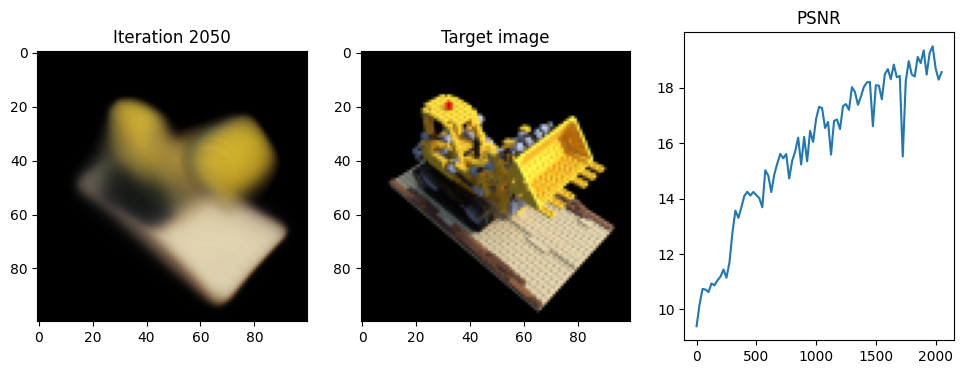

Iteration 2075  Loss: 0.0141  PSNR: 18.50  Time: 0.27 secs per iter,  9.54 mins in total


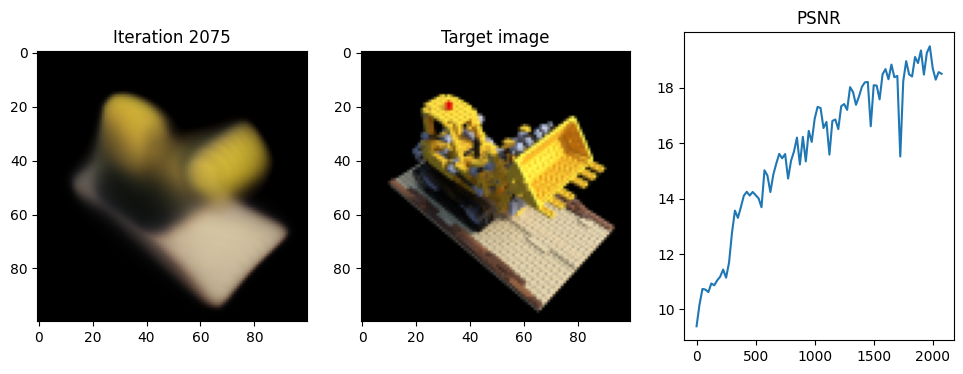

Iteration 2100  Loss: 0.0170  PSNR: 17.70  Time: 0.28 secs per iter,  9.66 mins in total


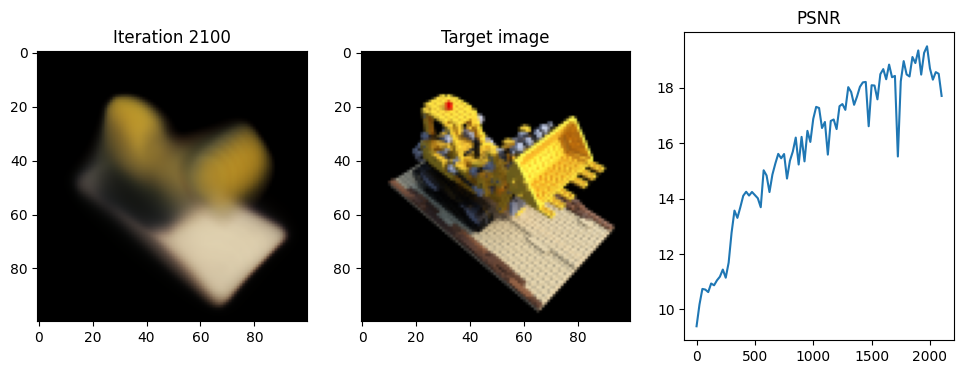

Iteration 2125  Loss: 0.0140  PSNR: 18.55  Time: 0.27 secs per iter,  9.77 mins in total


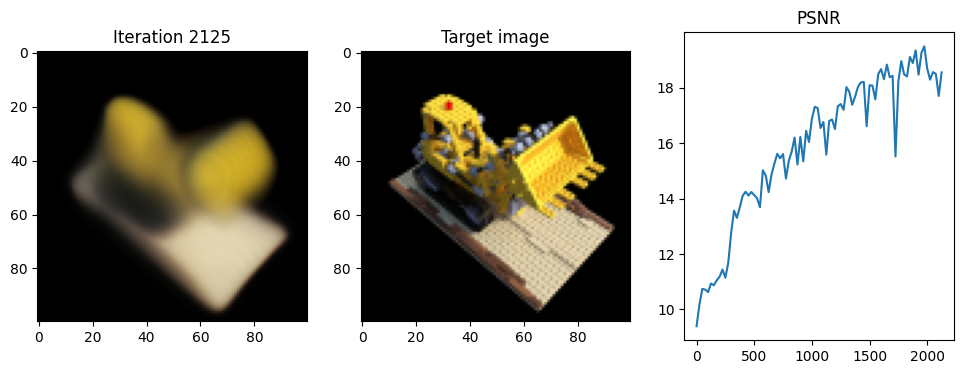

Iteration 2150  Loss: 0.0109  PSNR: 19.64  Time: 0.27 secs per iter,  9.89 mins in total


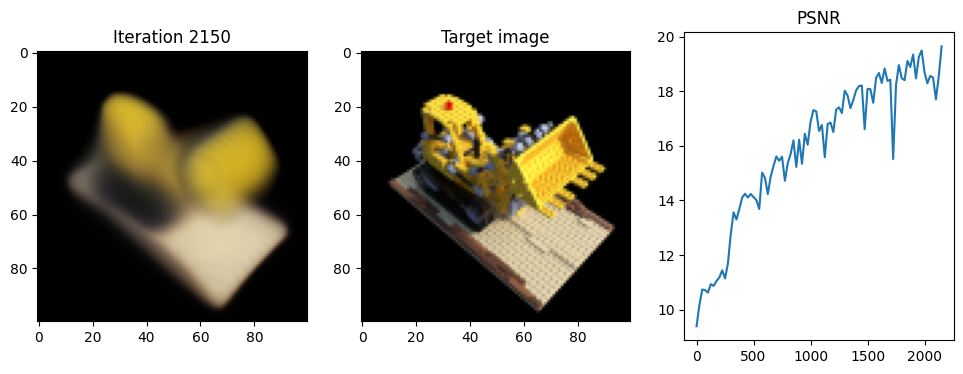

Iteration 2175  Loss: 0.0128  PSNR: 18.94  Time: 0.27 secs per iter,  10.00 mins in total


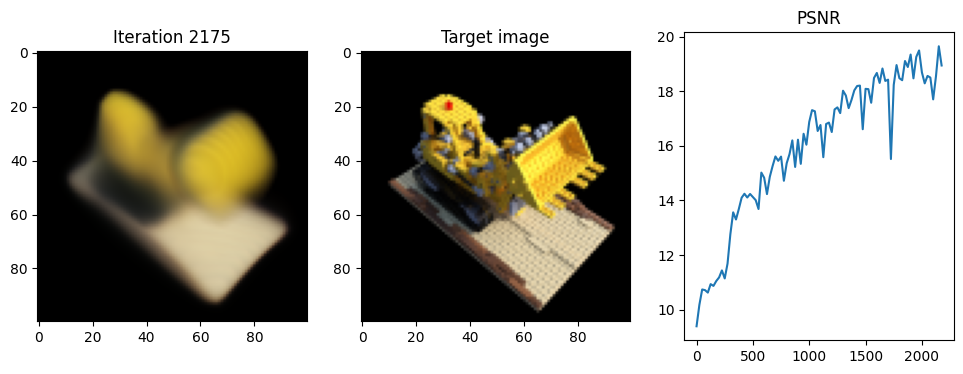

Iteration 2200  Loss: 0.0249  PSNR: 16.04  Time: 0.27 secs per iter,  10.12 mins in total


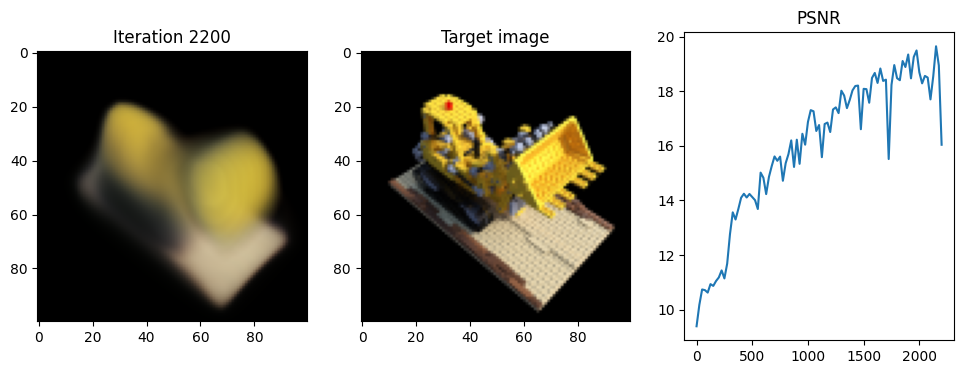

Iteration 2225  Loss: 0.0164  PSNR: 17.85  Time: 0.27 secs per iter,  10.23 mins in total


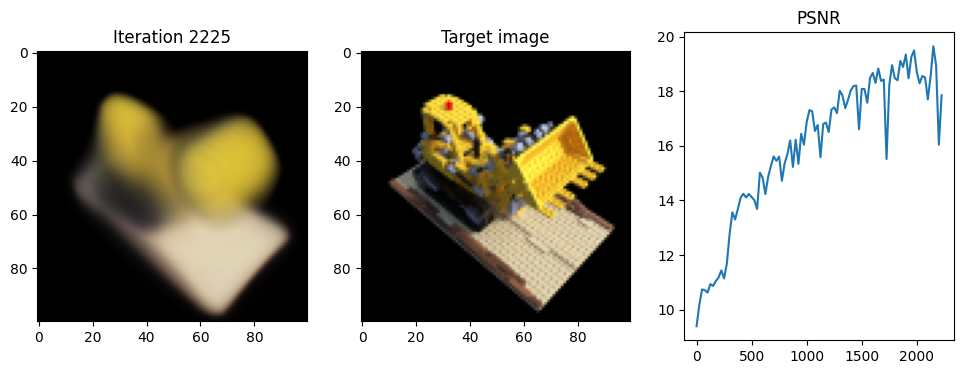

Iteration 2250  Loss: 0.0137  PSNR: 18.64  Time: 0.27 secs per iter,  10.35 mins in total


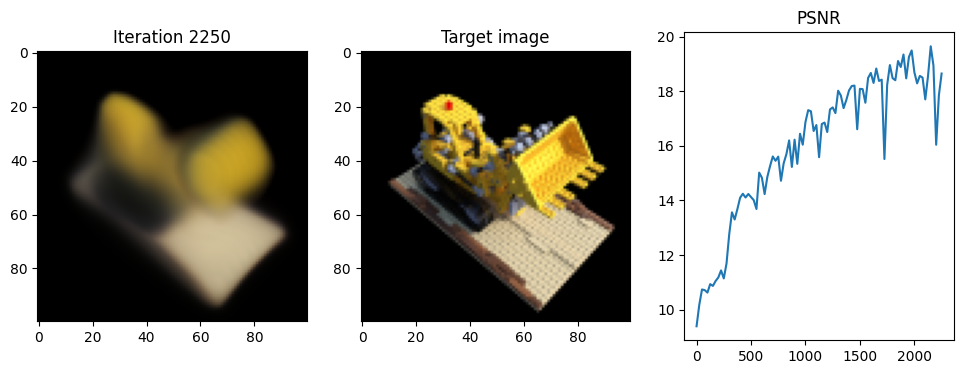

Iteration 2275  Loss: 0.0119  PSNR: 19.25  Time: 0.27 secs per iter,  10.46 mins in total


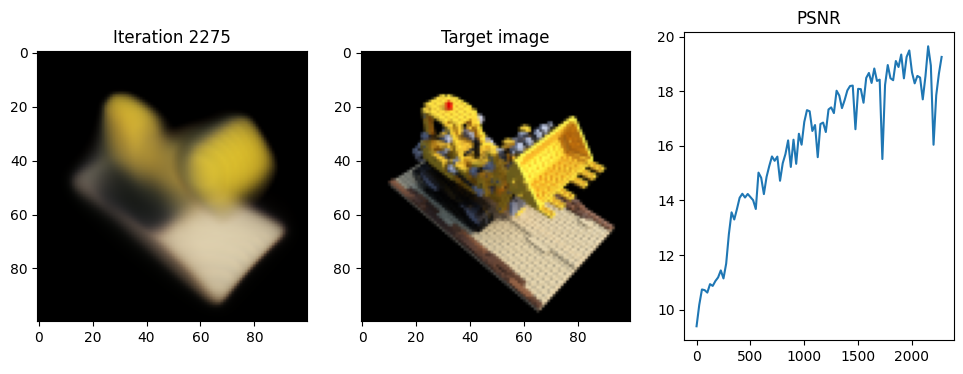

Iteration 2300  Loss: 0.0127  PSNR: 18.96  Time: 0.28 secs per iter,  10.58 mins in total


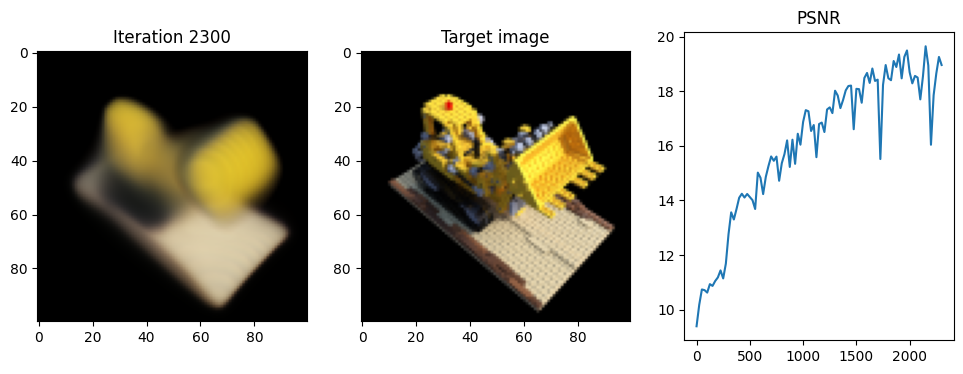

Iteration 2325  Loss: 0.0107  PSNR: 19.70  Time: 0.27 secs per iter,  10.69 mins in total


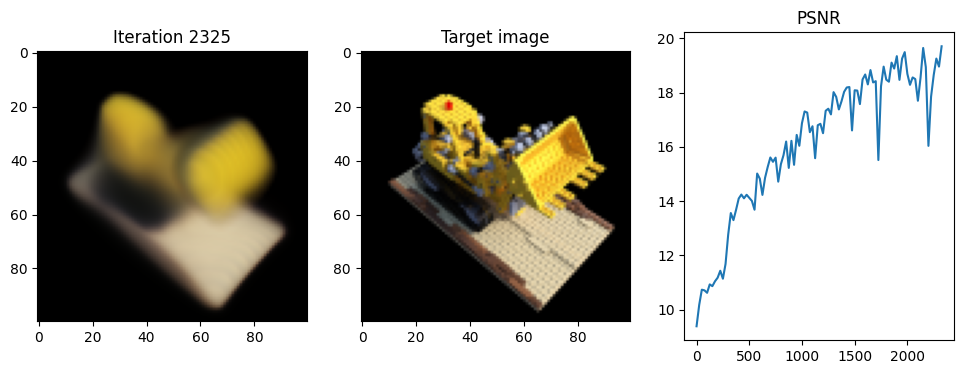

Iteration 2350  Loss: 0.0135  PSNR: 18.69  Time: 0.27 secs per iter,  10.80 mins in total


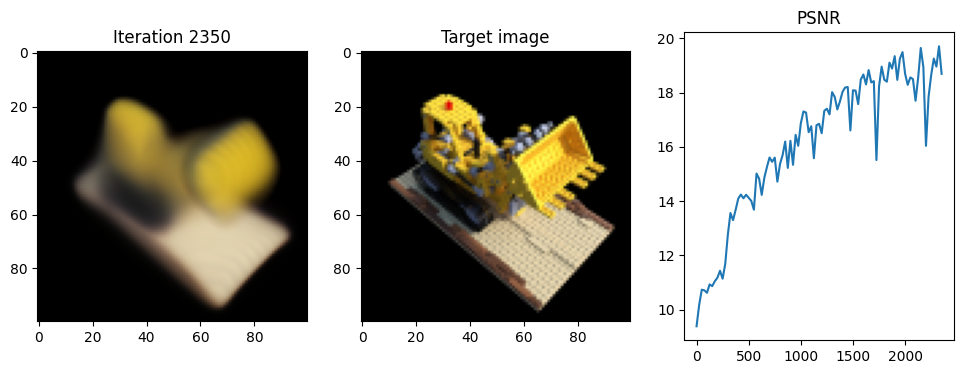

Iteration 2375  Loss: 0.0115  PSNR: 19.38  Time: 0.27 secs per iter,  10.92 mins in total


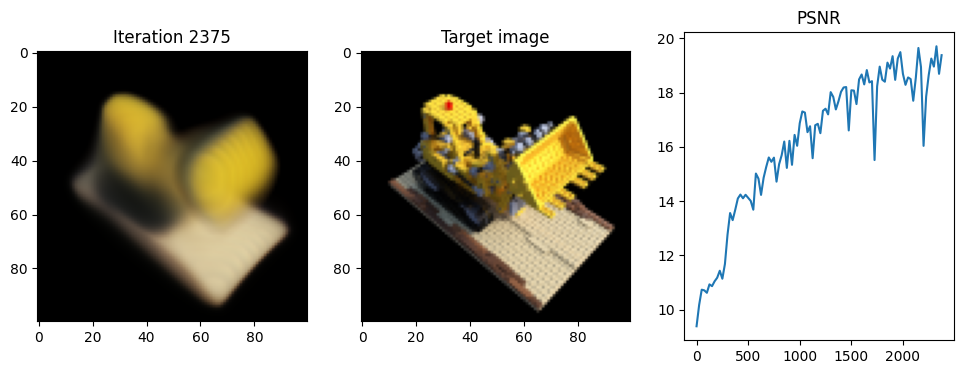

Iteration 2400  Loss: 0.0109  PSNR: 19.64  Time: 0.27 secs per iter,  11.03 mins in total


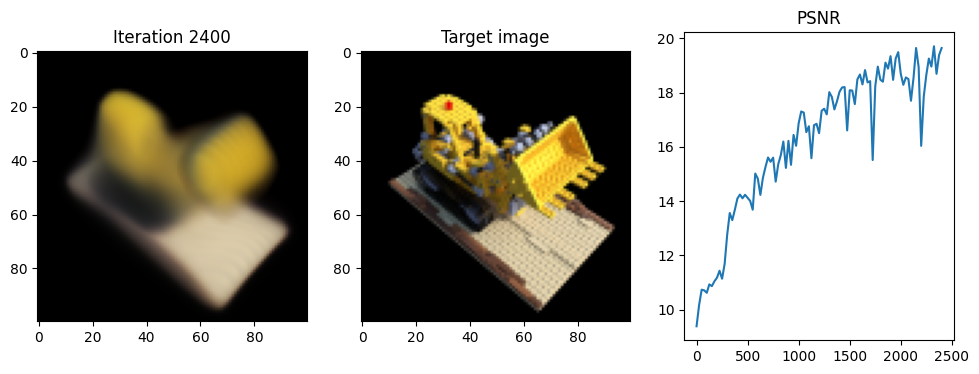

Iteration 2425  Loss: 0.0102  PSNR: 19.91  Time: 0.27 secs per iter,  11.15 mins in total


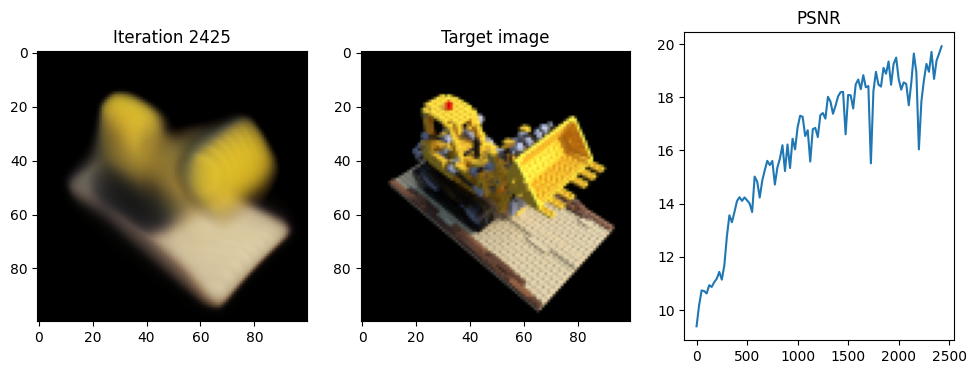

Iteration 2450  Loss: 0.0121  PSNR: 19.16  Time: 0.27 secs per iter,  11.26 mins in total


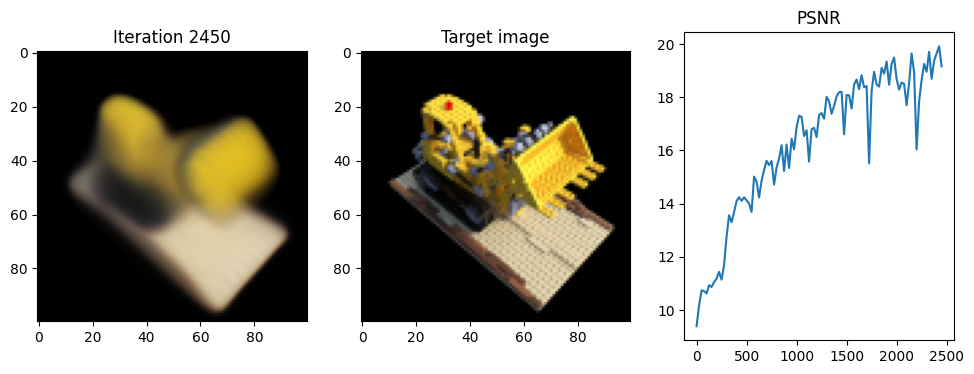

Iteration 2475  Loss: 0.0166  PSNR: 17.79  Time: 0.28 secs per iter,  11.38 mins in total


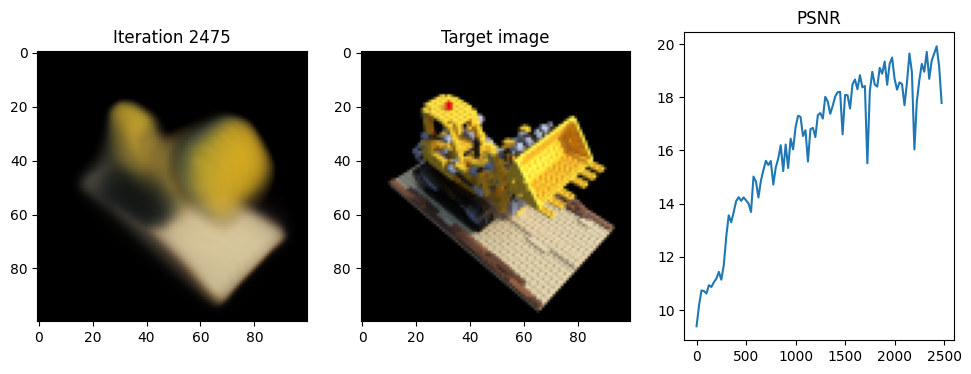

Iteration 2500  Loss: 0.0129  PSNR: 18.89  Time: 0.27 secs per iter,  11.49 mins in total


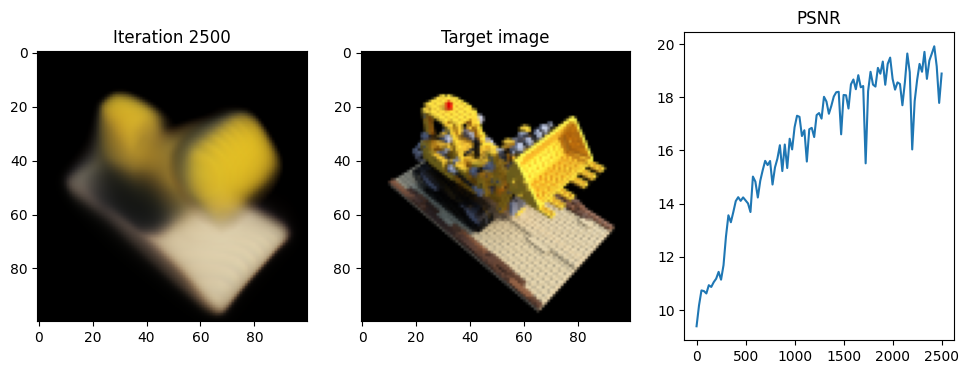

Iteration 2525  Loss: 0.0120  PSNR: 19.19  Time: 0.27 secs per iter,  11.60 mins in total


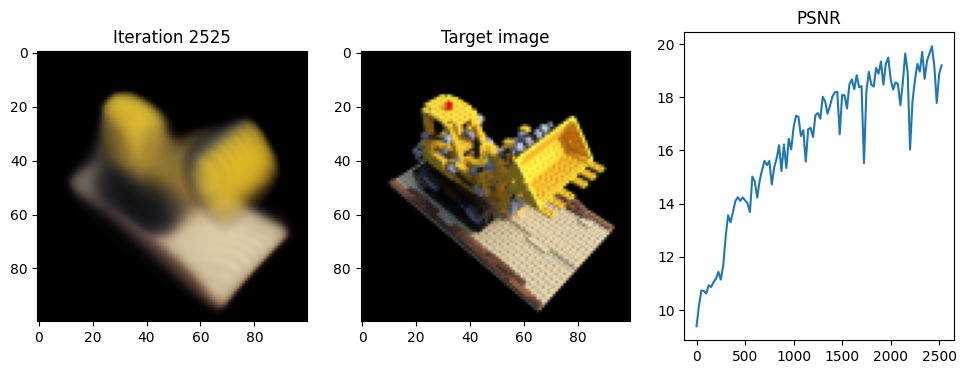

Iteration 2550  Loss: 0.0141  PSNR: 18.52  Time: 0.27 secs per iter,  11.72 mins in total


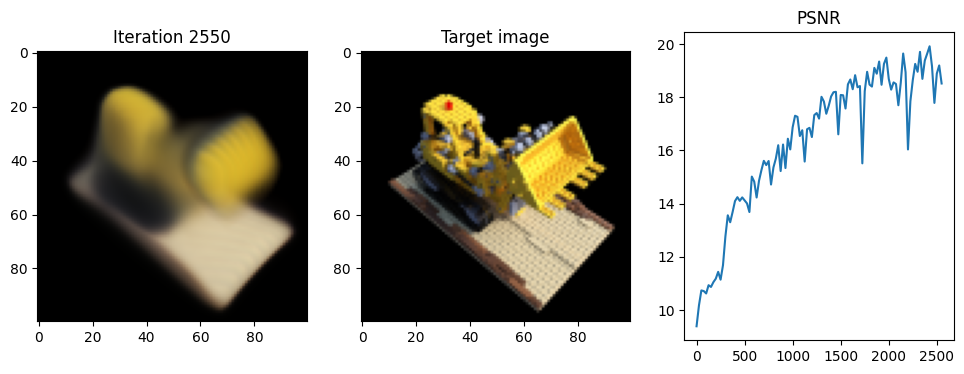

Iteration 2575  Loss: 0.0108  PSNR: 19.67  Time: 0.27 secs per iter,  11.83 mins in total


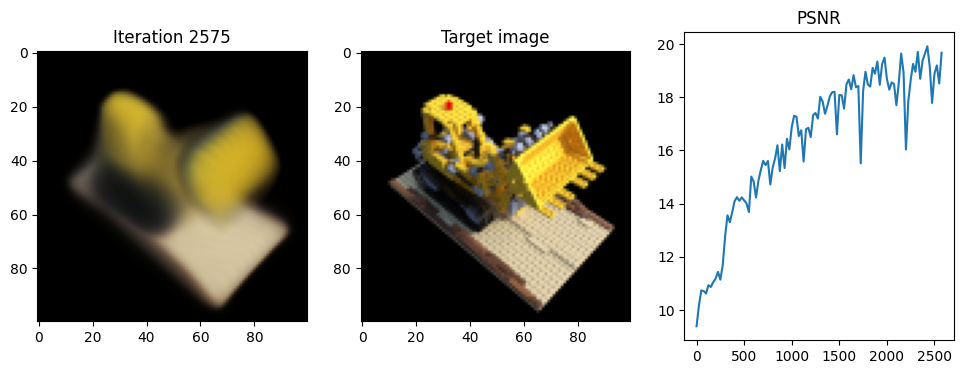

Iteration 2600  Loss: 0.0105  PSNR: 19.80  Time: 0.27 secs per iter,  11.95 mins in total


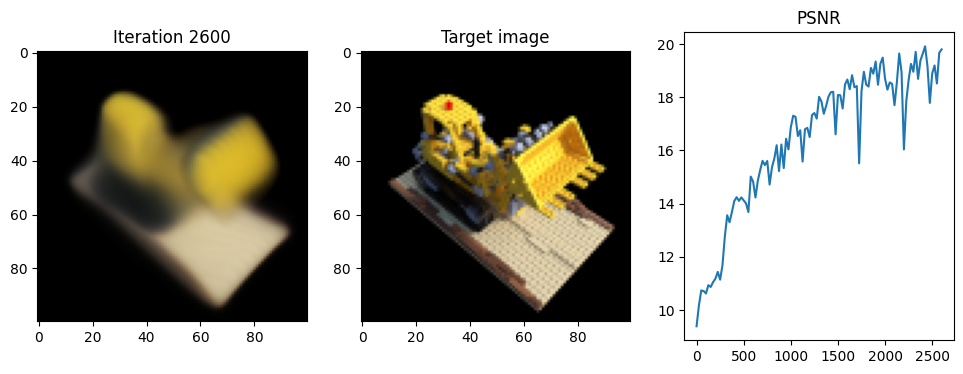

Iteration 2625  Loss: 0.0108  PSNR: 19.65  Time: 0.27 secs per iter,  12.06 mins in total


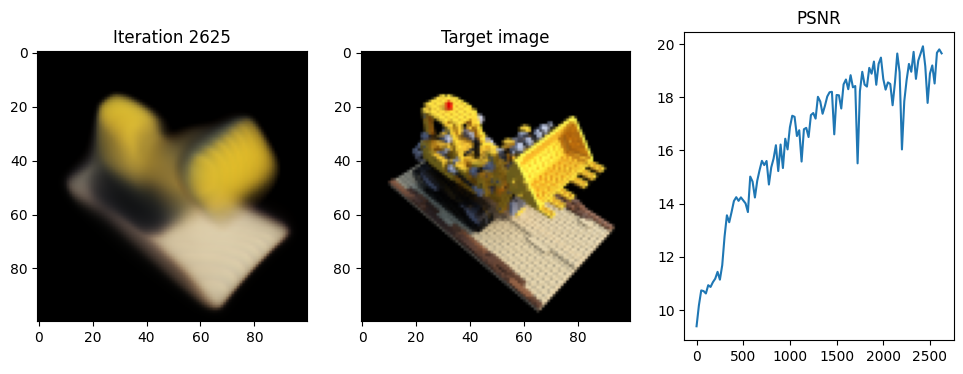

Iteration 2650  Loss: 0.0121  PSNR: 19.17  Time: 0.27 secs per iter,  12.18 mins in total


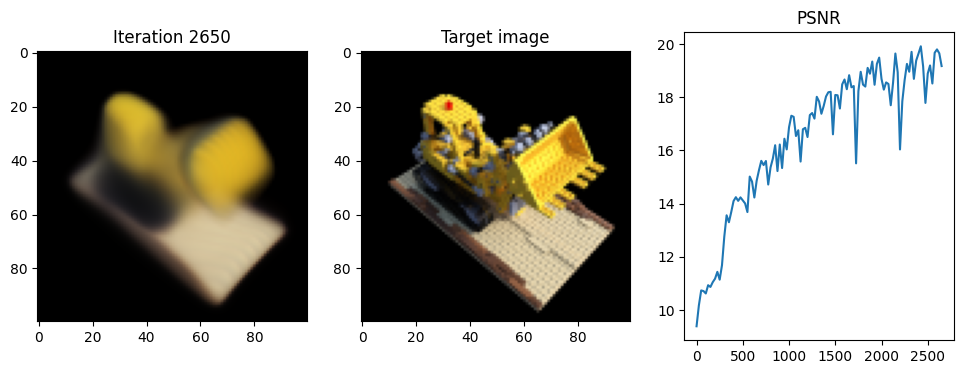

Iteration 2675  Loss: 0.0143  PSNR: 18.45  Time: 0.28 secs per iter,  12.29 mins in total


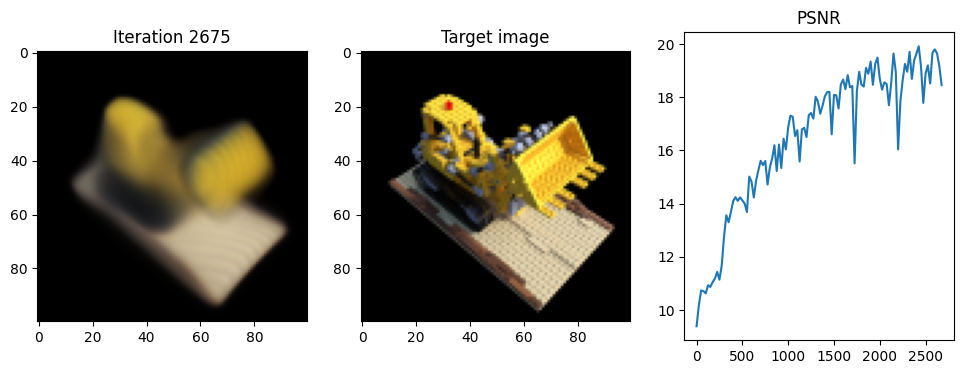

Iteration 2700  Loss: 0.0116  PSNR: 19.37  Time: 0.27 secs per iter,  12.41 mins in total


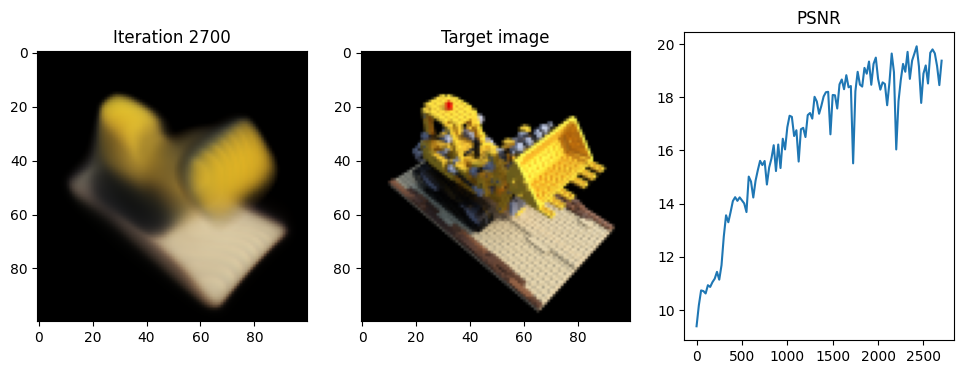

Iteration 2725  Loss: 0.0107  PSNR: 19.73  Time: 0.27 secs per iter,  12.52 mins in total


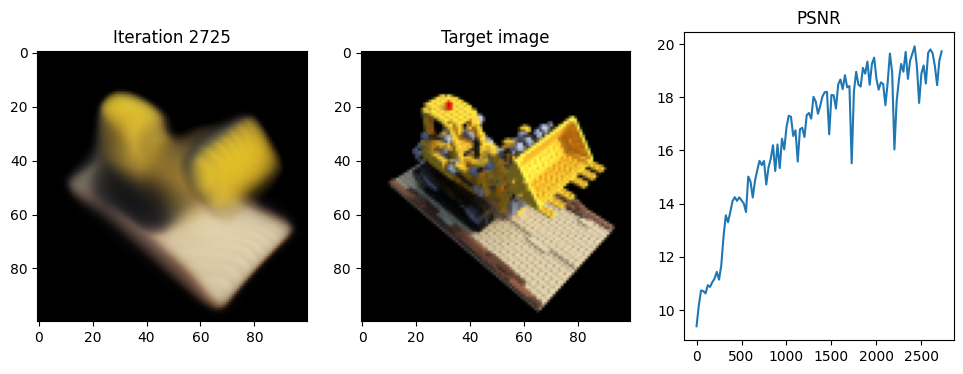

Iteration 2750  Loss: 0.0111  PSNR: 19.56  Time: 0.27 secs per iter,  12.63 mins in total


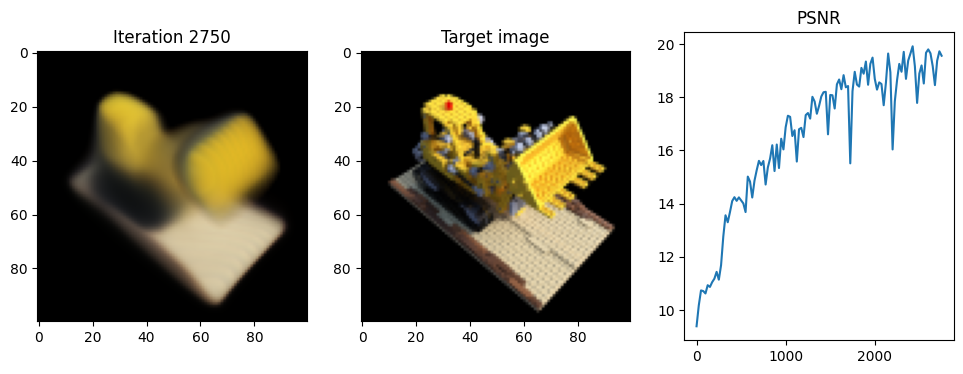

Iteration 2775  Loss: 0.0114  PSNR: 19.44  Time: 0.27 secs per iter,  12.75 mins in total


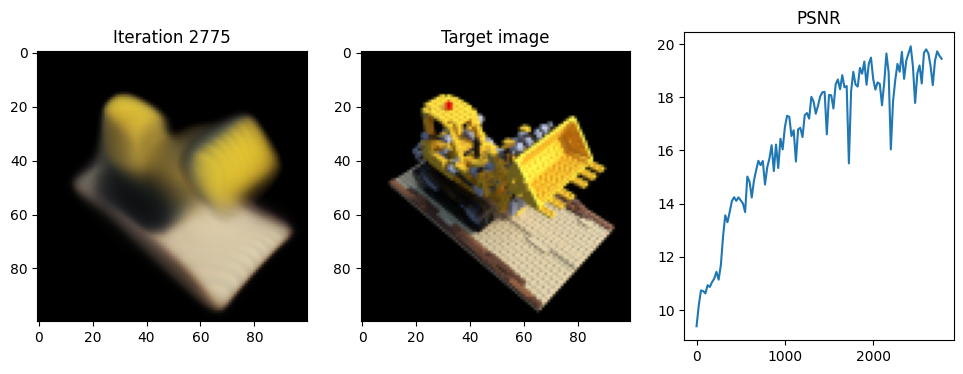

Iteration 2800  Loss: 0.0101  PSNR: 19.94  Time: 0.27 secs per iter,  12.86 mins in total


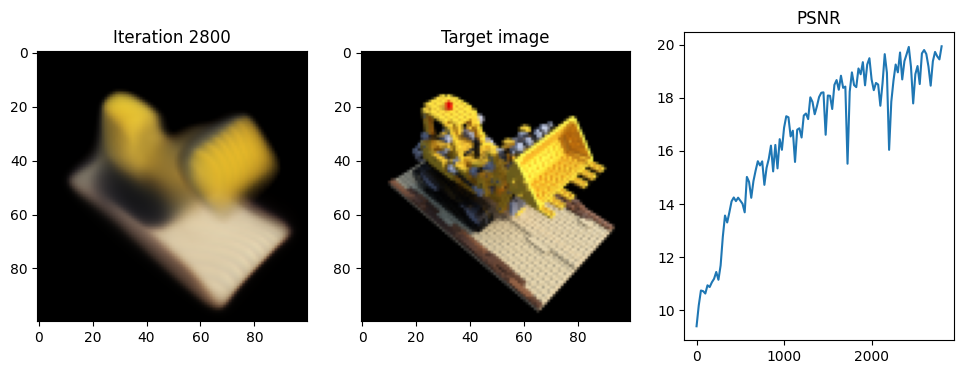

Iteration 2825  Loss: 0.0121  PSNR: 19.15  Time: 0.27 secs per iter,  12.98 mins in total


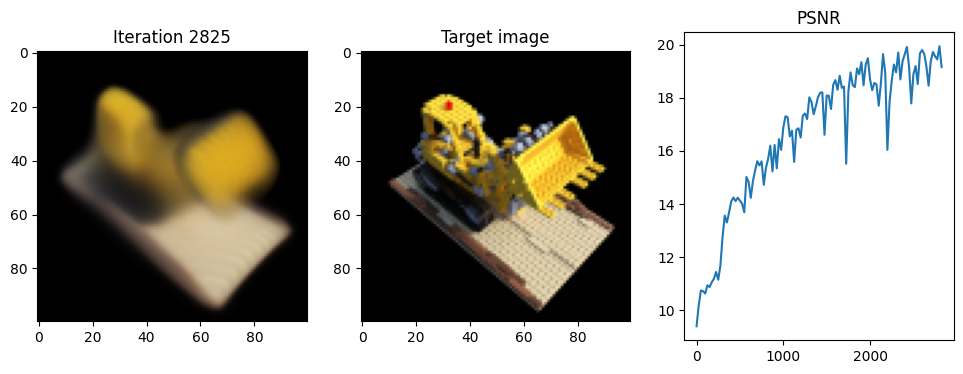

Iteration 2850  Loss: 0.0131  PSNR: 18.81  Time: 0.27 secs per iter,  13.09 mins in total


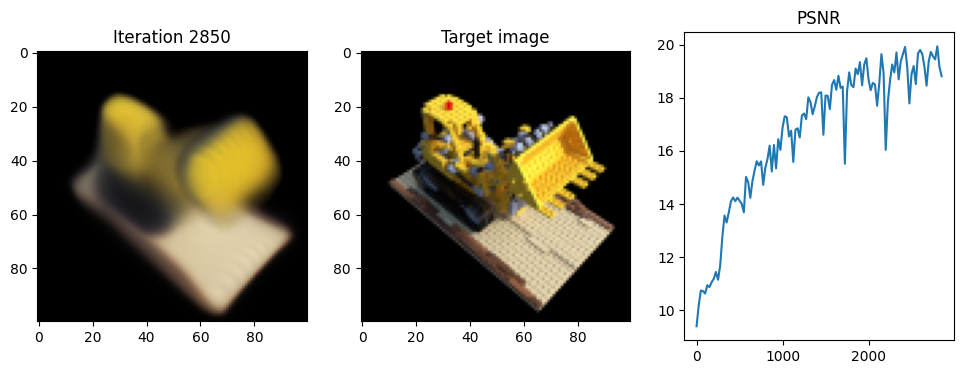

Iteration 2875  Loss: 0.0108  PSNR: 19.65  Time: 0.28 secs per iter,  13.21 mins in total


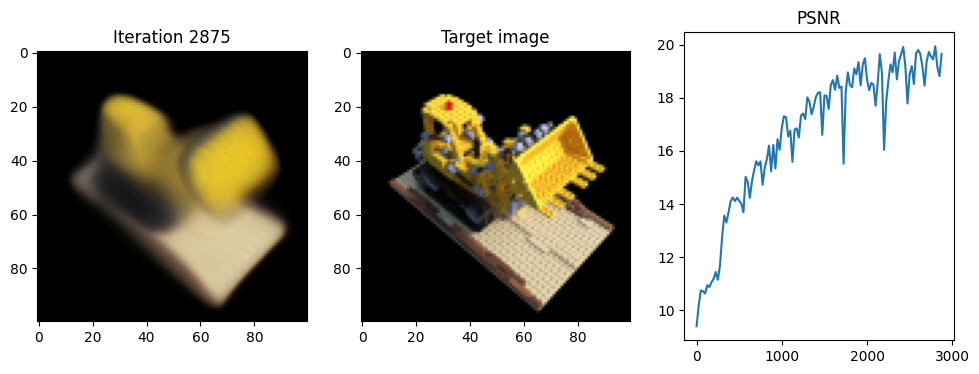

Iteration 2900  Loss: 0.0098  PSNR: 20.08  Time: 0.27 secs per iter,  13.32 mins in total


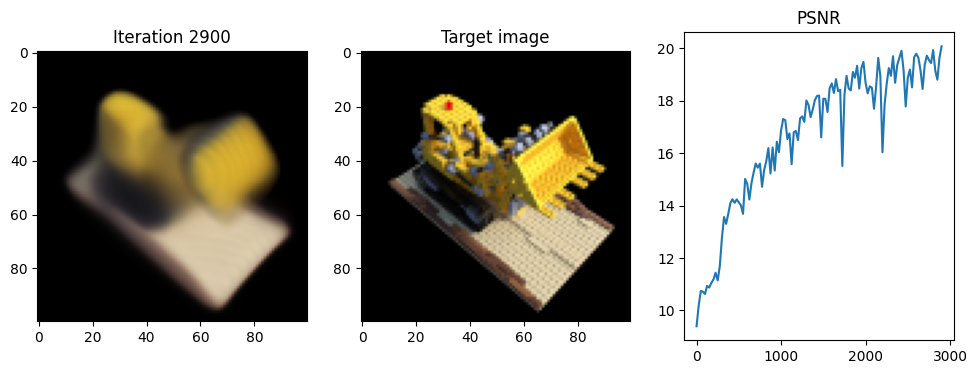

Iteration 2925  Loss: 0.0113  PSNR: 19.47  Time: 0.27 secs per iter,  13.43 mins in total


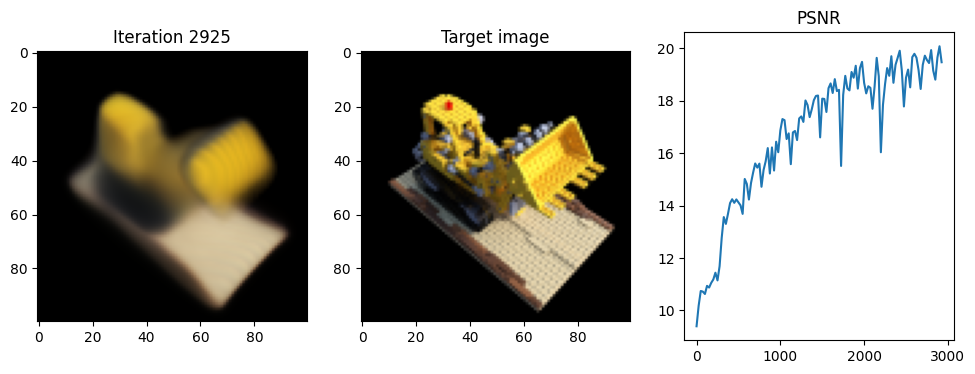

Iteration 2950  Loss: 0.0096  PSNR: 20.20  Time: 0.27 secs per iter,  13.55 mins in total


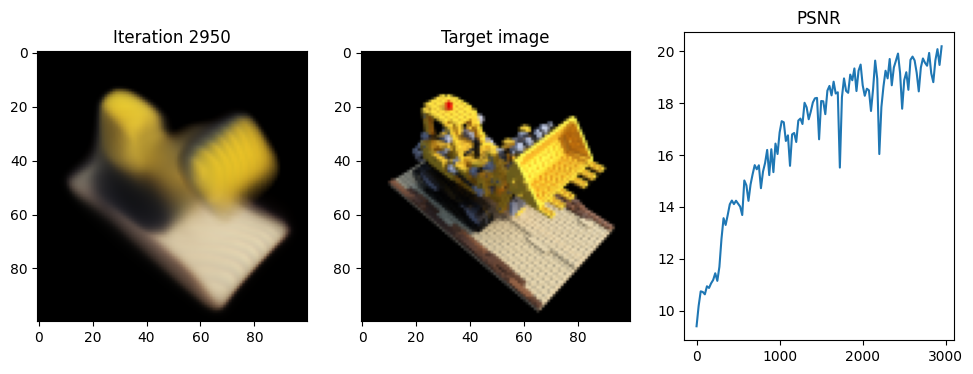

Iteration 2975  Loss: 0.0129  PSNR: 18.89  Time: 0.27 secs per iter,  13.66 mins in total


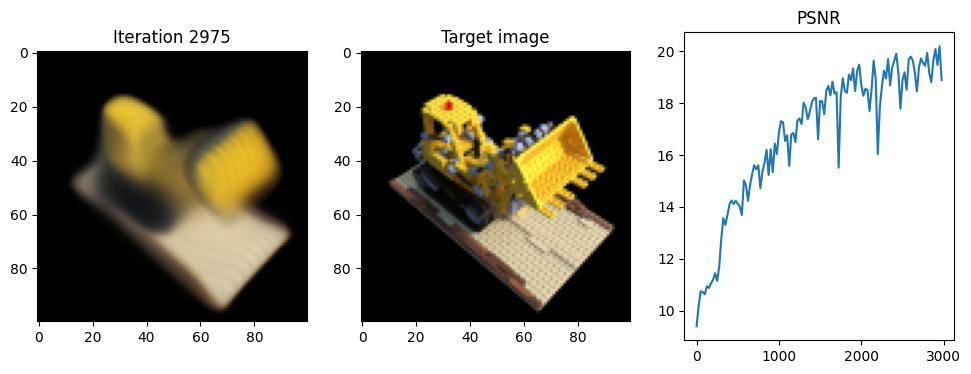

Iteration 3000  Loss: 0.0093  PSNR: 20.31  Time: 0.27 secs per iter,  13.78 mins in total


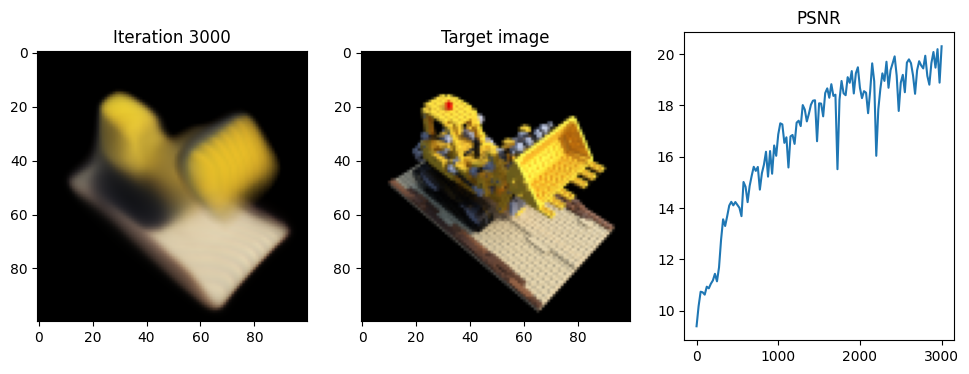

Done!


In [13]:
for i in range(iterations+1):


    #choose randomly a picture for the forward pass
    output_image_idx = np.random.choice(images.shape[0])
    output_image = images[output_image_idx,...]
    pose = poses[output_image_idx,...]
    # Run one iteration of NeRF and get the rendered RGB image.
    optimizer.zero_grad()
    rec_image = one_forward_pass(height, width, intrinsics, pose, near, far, samples, model, num_x_frequencies, num_d_frequencies)

    loss = criterion(rec_image, output_image)
    loss.backward()
    optimizer.step()




    # Display images/plots/stats
    if i % display == 0:
        with torch.no_grad():

            # Render the held-out view
            test_rec_image = one_forward_pass(height, width, intrinsics, test_pose, near, far, samples, model, num_x_frequencies, num_d_frequencies)


            #calculate the loss and the psnr between the original test image and the reconstructed one.
            loss = criterion(test_rec_image, test_image)
        psnr = 10 * torch.log10((torch.max(test_image)**2)/loss.item())

   

        print("Iteration %d " % i, "Loss: %.4f " % loss.item(), "PSNR: %.2f " % psnr.item(), \
                "Time: %.2f secs per iter, " % ((time.time() - t) / display), "%.2f mins in total" % ((time.time() - t0)/60))

        t = time.time()
        psnrs.append(psnr.item())
        iternums.append(i)

        plt.figure(figsize=(16, 4))
        plt.subplot(141)
        plt.imshow(test_rec_image.detach().cpu().numpy())
        plt.title(f"Iteration {i}")
        plt.subplot(142)
        plt.imshow(test_image.detach().cpu().numpy())
        plt.title("Target image")
        plt.subplot(143)
        plt.plot(iternums, psnrs)
        plt.title("PSNR")
        plt.show()

plt.imsave('test_lego-wo_PE.png',test_rec_image.detach().cpu().numpy())
torch.save(model.state_dict(),'model_nerf-wo_PE.pt')
print('Done!')